In [1]:
# Importing all the required libraries

import cv2
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import collections

from moviepy.editor import VideoFileClip
from IPython.display import HTML

%matplotlib qt
%matplotlib inline

In [2]:
#directory names to store various different images

chessboard_dir = "camera_cal/"
chessboard_output_dir = "camera_cal_output/"
test_image_dir = "test_images/"
undistorted_dir = "test_images_undistort/"
thresholded_dir = "test_images_threshold/"
lane_image_dir = "test_images_lane/"
warped_image_dir = "test_images_warped/"
sliding_window_dir = "test_images_sliding/"
solid_lines_dir = "test_images_solid/"
test_output_dir = "test_images_output/"
chessboard_undistort_dir = "camera_cal_undistort/"

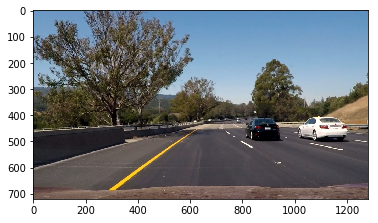

In [3]:
test_image_1 = cv2.imread("test_images/test6.jpg")
test_image_1 = cv2.cvtColor(test_image_1, cv2.COLOR_BGR2RGB)
image_size = (test_image_1.shape[1], test_image_1.shape[0])

plt.imshow(test_image_1)
plt.show()

In [4]:
# Function to save images in a dirctory.

def save_image(output_dir, image_name, image):
    if (os.path.exists(output_dir) == False):
        print("Output directory doesnt exists. Creating it to save output images")
        os.mkdir(output_dir)
    mpimg.imsave(output_dir + image_name, image)
    

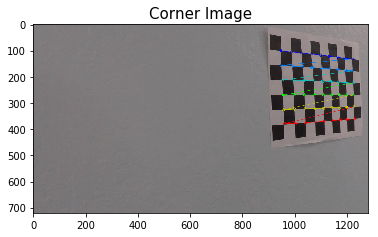

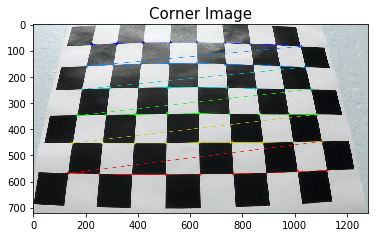

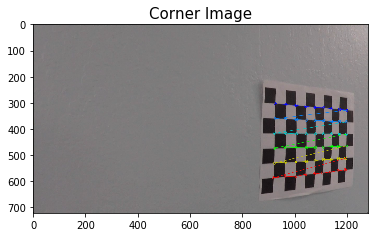

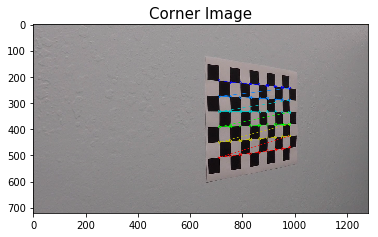

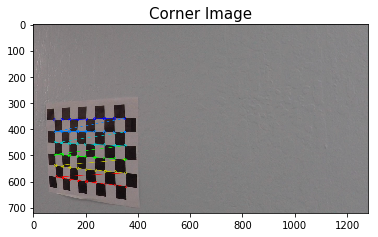

...

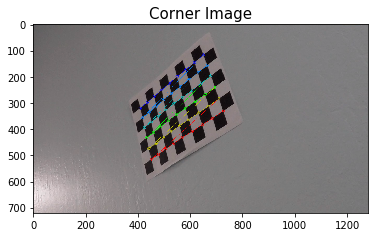

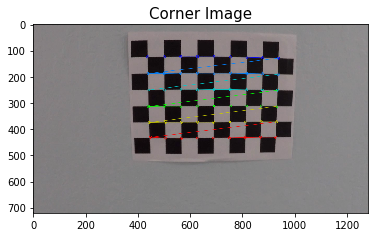

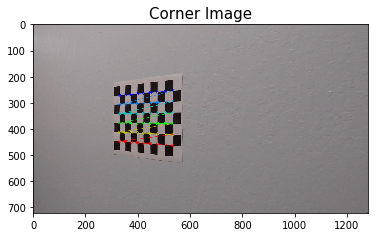

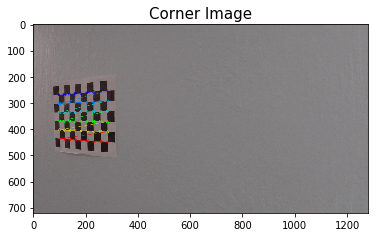

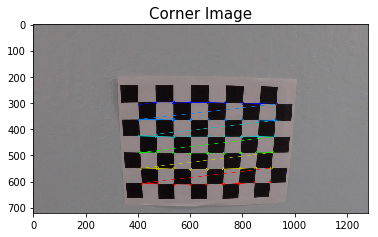

In [5]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
nx = 9
ny = 6

objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = os.listdir(chessboard_dir)

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(chessboard_dir + fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        save_image(chessboard_output_dir, fname, img)
        plt.imshow(img)
        plt.title("Corner Image", fontsize = 15)
        plt.show()
        

## Undistorting the image

In [6]:
#Finding camera caliberation coefficients

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, image_size,None,None)

In [7]:
#Function to undistort the image.

def undistort(img, mtx, dist):
    return cv2.undistort(img, mtx, dist, None, mtx)

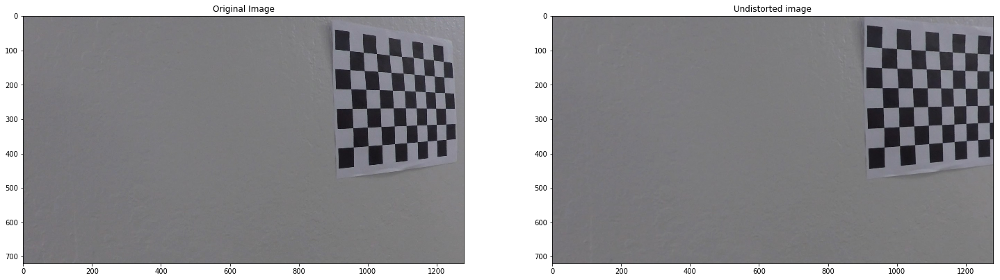

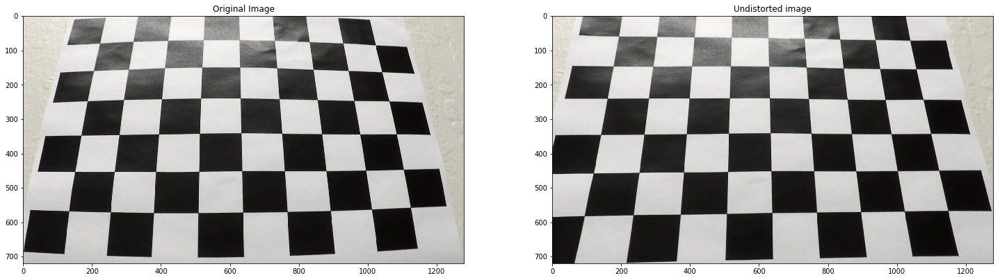

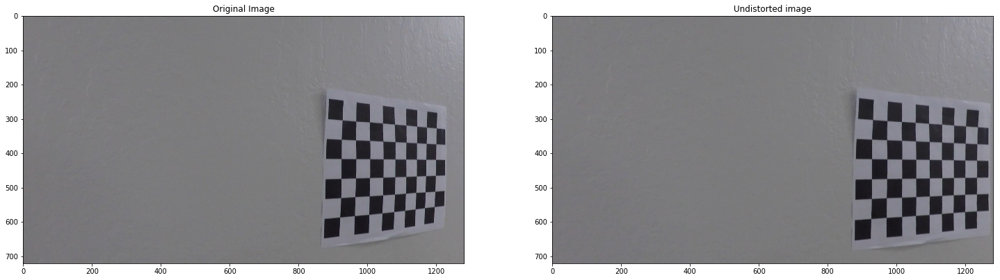

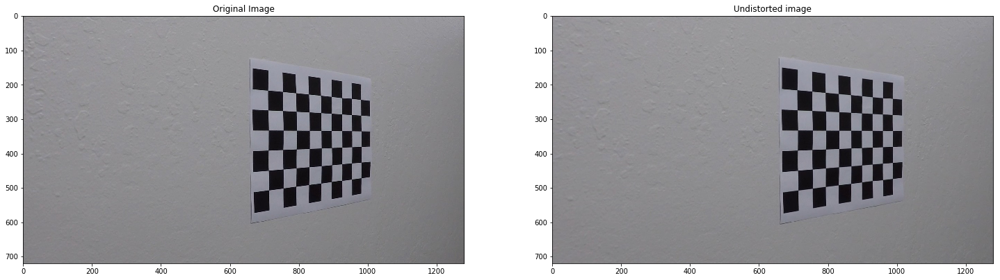

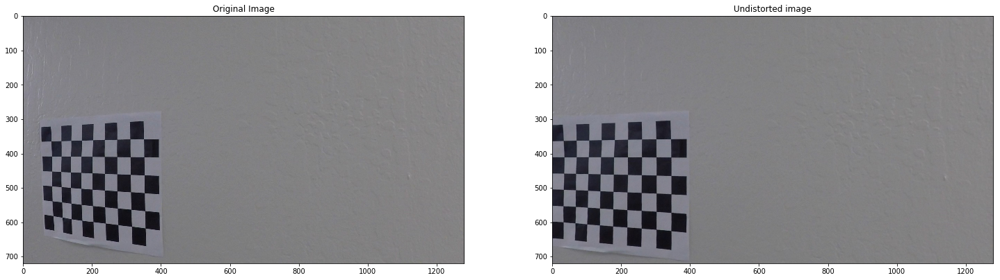

...

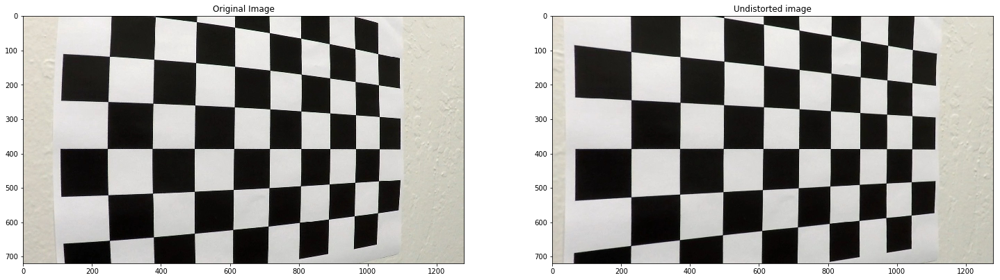

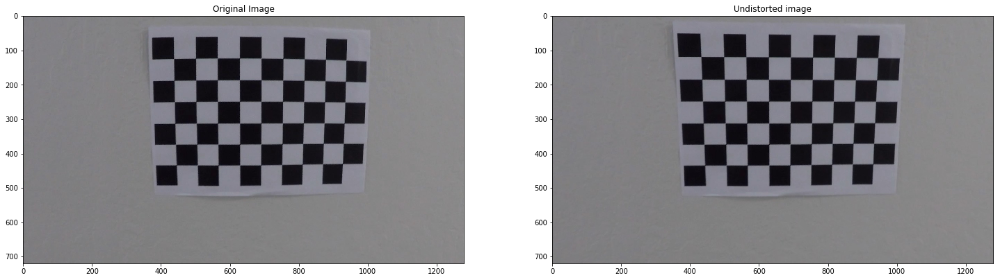

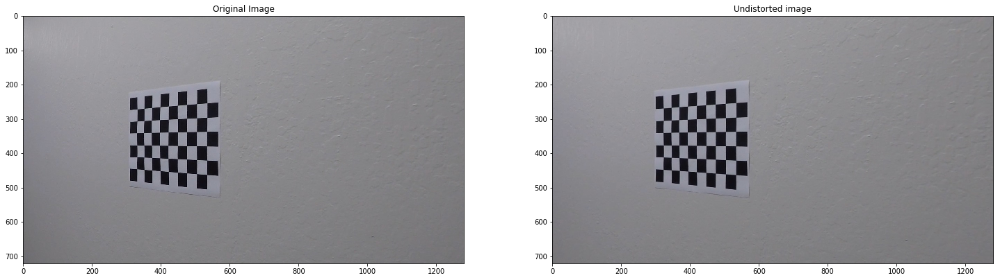

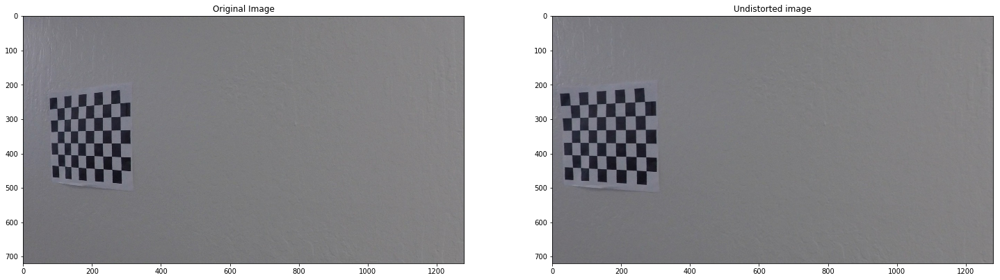

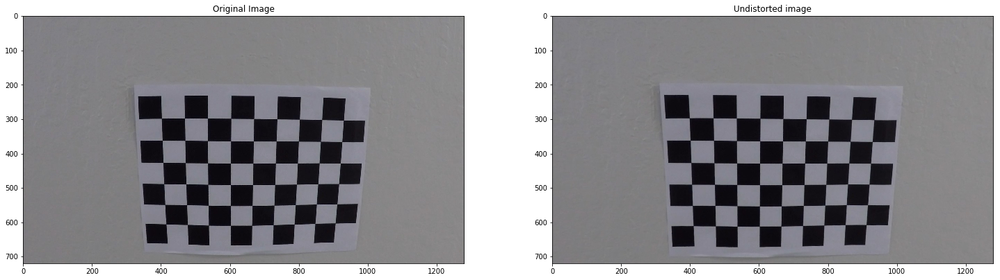

In [8]:
# Undistorting the chessboard images and saving them to a directory.

chessboard_images = os.listdir(chessboard_dir)

for chessboard_image in chessboard_images:
    img = cv2.imread(chessboard_dir + chessboard_image)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    undistort_chessboard = undistort(img, mtx, dist)
    
    save_image(chessboard_undistort_dir, chessboard_image, undistort_chessboard)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize = (25, 15))
    
    ax1.imshow(img)
    ax1.set_title("Original Image")
    
    ax2.imshow(undistort_chessboard)
    ax2.set_title("Undistorted image")

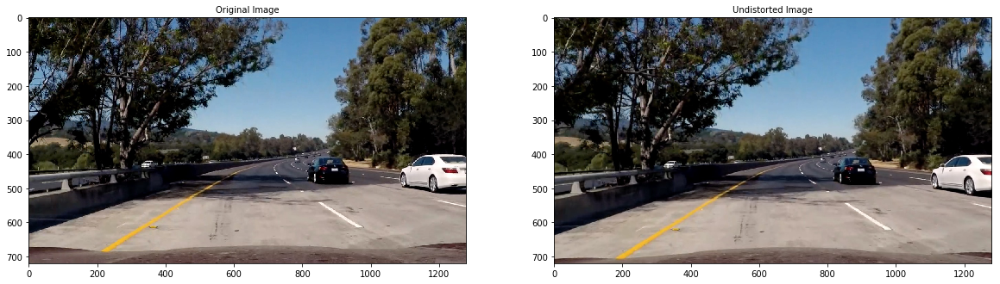

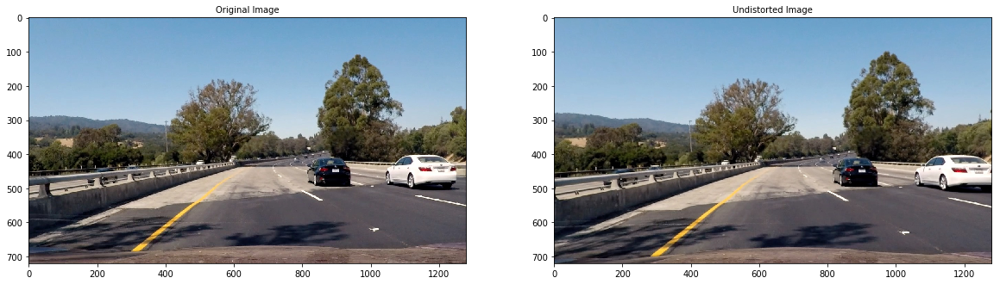

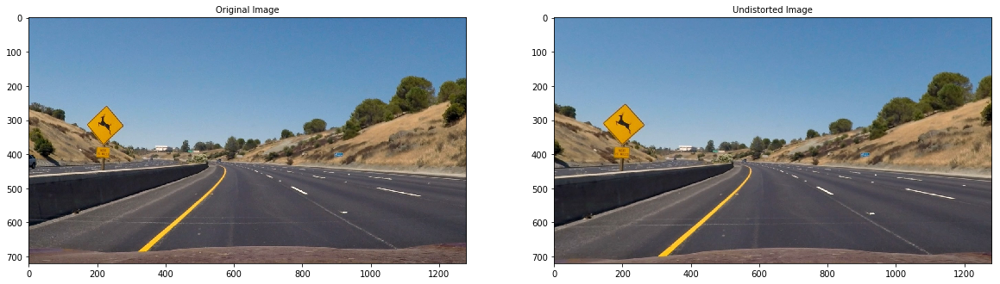

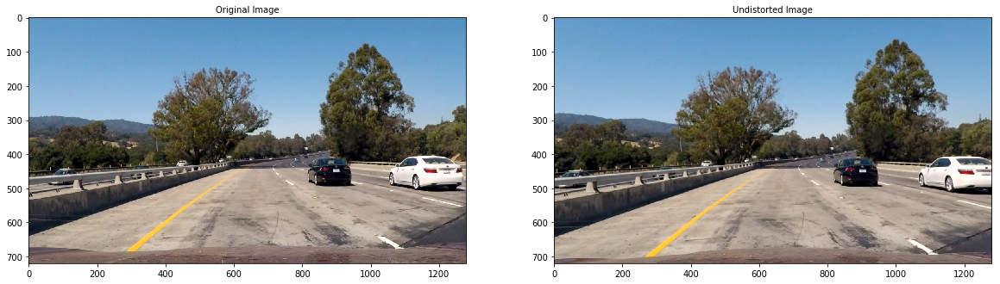

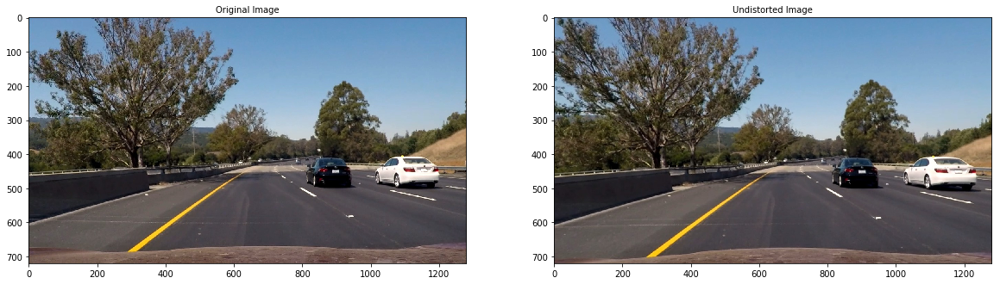

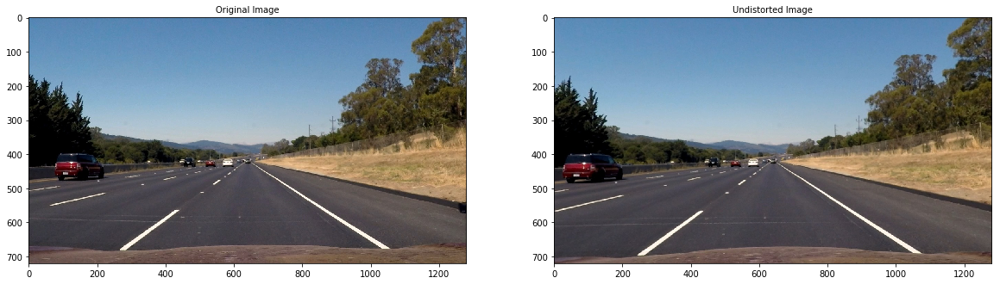

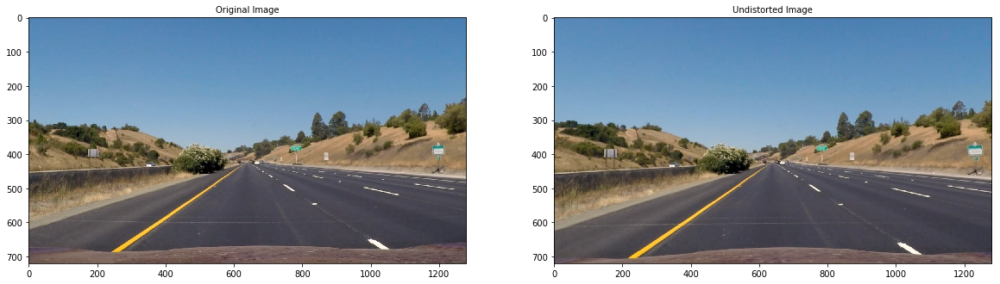

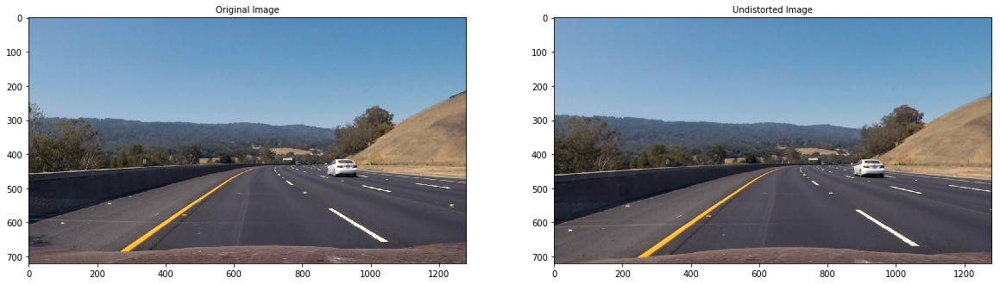

In [9]:
# Undistorting the test images and saving the undistorted images.

test_images = os.listdir(test_image_dir)

for image_name in test_images:
    img = cv2.imread(test_image_dir + image_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undistorted_img = undistort(img, mtx, dist)
    save_image(undistorted_dir, image_name, undistorted_img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=10)
    ax2.imshow(undistorted_img)
    ax2.set_title('Undistorted Image', fontsize=10)

In [10]:
# Absolute sobel x or y

def abs_sobel_thresh(img, orient='x', sobel_kernel = 3, thresh = (0, 255)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Apply cv2.Sobel()
    if orient == "x":
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    else:
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
        
    # Take the absolute value of the output from cv2.Sobel()
    abs_sobel = np.absolute(sobel)
    
    # Scale the result to an 8-bit range (0-255)
    abs_scale_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # Apply lower and upper thresholds
    thresh_filter = (abs_scale_sobel >= thresh[0]) & (abs_scale_sobel <= thresh[1])
    # Create binary_output
    
    binary_output = np.zeros_like(abs_scale_sobel)
    binary_output[thresh_filter] = 1
    return binary_output

In [11]:
# Magnitude Sobel function

def mag_thresh(img, sobel_kernel = 3, thresh = (0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    
    magx = np.sqrt(sobelx**2)
    magy = np.sqrt(sobely**2)
    magxy = np.sqrt(sobelx**2 + sobely**2)
    
    scaled_magxy = np.uint8(255*magxy / np.max(magxy))
    
    binary_output = np.zeros_like(scaled_magxy)
    
    thresh_filter = (scaled_magxy >= thresh[0]) & (scaled_magxy <= thresh[1])
    
    binary_output[thresh_filter] = 1
    
    return binary_output

In [12]:
# Direction Sobel Function

def dir_thresh(img, sobel_kernel = 3, thresh = (0, np.pi/2)):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    
    magx = np.sqrt(sobelx**2)
    magy = np.sqrt(sobely**2)
    
    magx_abs = np.absolute(magx)
    magy_abs = np.absolute(magy)
    
    direction = np.arctan2(magy_abs, magx_abs)
    
    binary_output = np.zeros_like(direction)
    
    thresh_filter = (direction >= thresh[0]) & (direction <= thresh[1])
    
    binary_output[thresh_filter] = 1
    
    return binary_output

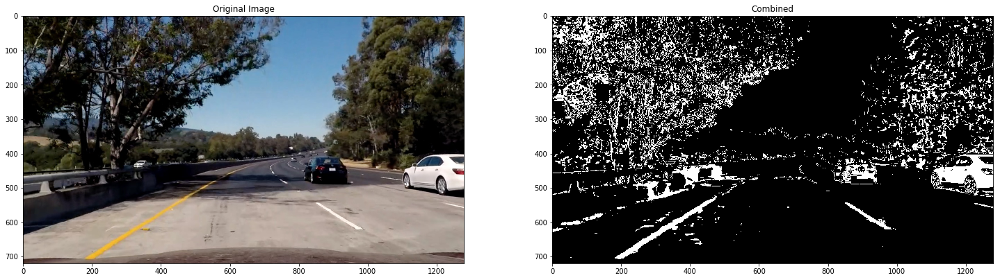

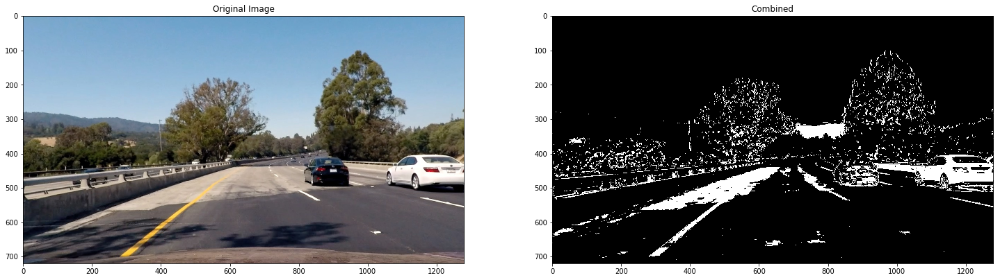

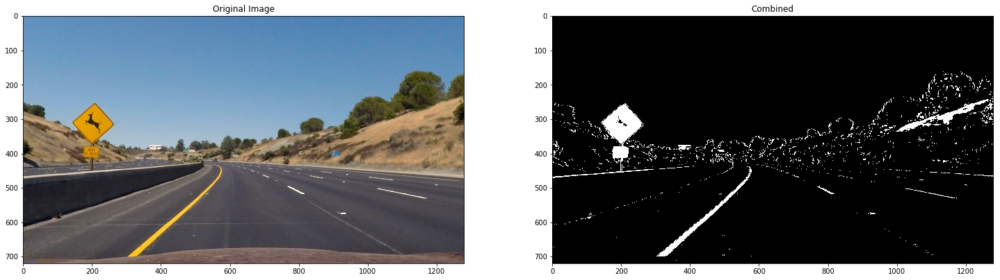

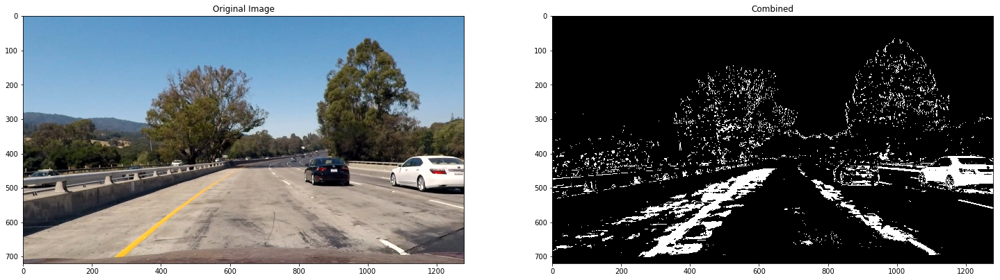

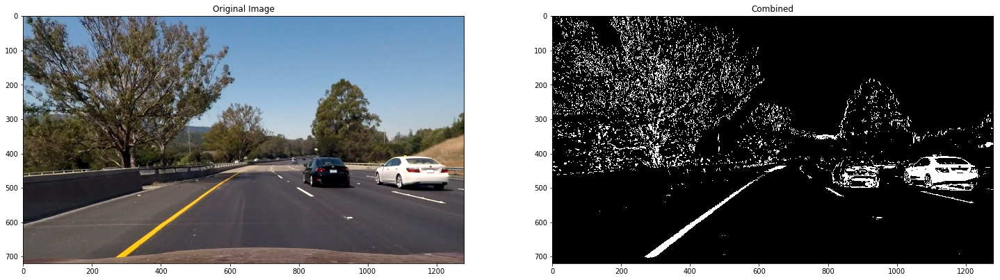

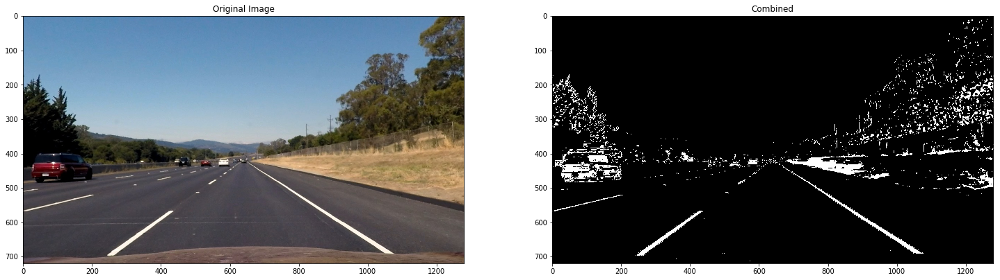

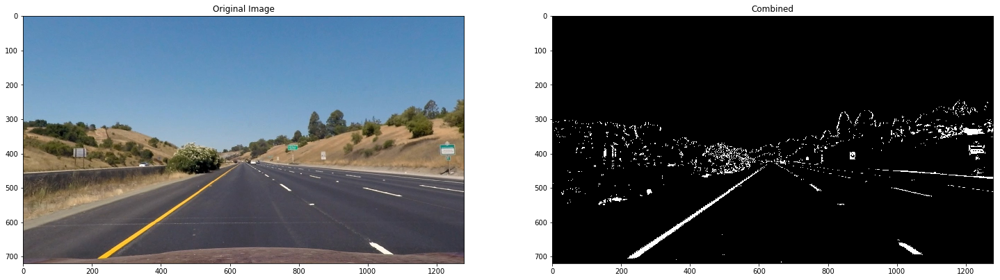

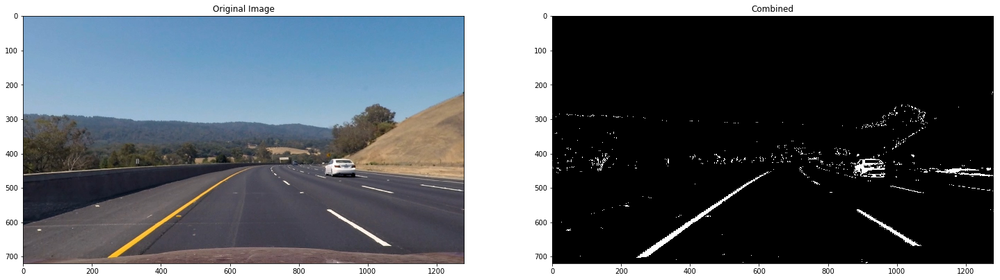

In [13]:
# Combining various gradient thresholds along with RGB and HLS thresholds 
#to come up with best possible detection of lane lines

undist_images = os.listdir(undistorted_dir)

for image_name in undist_images:
    img = cv2.imread(undistorted_dir + image_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    x_sobel = abs_sobel_thresh(img, orient='x', sobel_kernel = 3, thresh = (40, 100))
    y_sobel = abs_sobel_thresh(img, orient='y', sobel_kernel = 3, thresh = (20, 100))
    mag_sobel = mag_thresh(img, sobel_kernel = 3, thresh = (20, 100))
    dir_sobel = dir_thresh(img, sobel_kernel=3, thresh=(0.7, 1.4))
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    R_thresh = (200, 255)
    S_thresh = (150, 255)
    
    R = img[:, :, 0]
    G = img[:, :, 1]
    B = img[:, :, 2]
    binary_r = np.zeros_like(R)
    binary_r[(R >= R_thresh[0]) & (R <= R_thresh[1])] = 1
    
    
    H = hls[:, :, 0]
    L = hls[:, :, 1]
    S = hls[:, :, 2]
    binary_s = np.zeros_like(S)
    binary_s[(S >= S_thresh[0]) & (S <= S_thresh[1])] = 1
    
    binary_sobel = np.zeros_like(y_sobel)
    binary_sobel[(x_sobel == 1) & (mag_sobel == 1)]=1
    
    binary_color = np.zeros_like(R)
    binary_color[(binary_r == 1) | (binary_s == 1)] = 1
    
    binary_output = np.zeros_like(R)
    binary_output[(binary_sobel == 1) | (binary_color == 1)] = 1
    
    #f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize = (25, 20))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize = (25, 20))
    
    """ax1.imshow(img)
    ax1.set_title("Original Image")
    
    ax2.imshow(x_sobel, cmap = "gray")
    ax2.set_title("X grad")
    
    ax3.imshow(y_sobel, cmap = "gray")
    ax3.set_title("Y grad")
    
    ax4.imshow(binary, cmap = "gray")
    ax4.set_title("Combined")"""
    
    ax1.imshow(img, cmap = "gray")
    ax1.set_title("Original Image")
    
    ax2.imshow(binary_output, cmap = "gray")
    ax2.set_title("Combined")
    
    #ax3.imshow(binary, cmap = "gray")
    #ax3.set_title("Mag thresh")

In [14]:
#Function to get the binary thresholded image with lane lines detected.

def threshold(img, show = False):
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    x_sobel = abs_sobel_thresh(img, orient='x', sobel_kernel = 15, thresh = (20, 150))
    y_sobel = abs_sobel_thresh(img, orient='y', sobel_kernel = 3, thresh = (20, 150))
    mag_sobel = mag_thresh(img, sobel_kernel = 9, thresh = (50, 255))
    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    R_thresh = (200, 255)
    S_thresh = (90, 255)
    
    R = img[:, :, 0]
    G = img[:, :, 1]
    B = img[:, :, 2]
    binary_r = np.zeros_like(R)
    binary_r[(R >= R_thresh[0]) & (R <= R_thresh[1])] = 1
    
    
    H = hls[:, :, 0]
    L = hls[:, :, 1]
    S = hls[:, :, 2]
    binary_s = np.zeros_like(S)
    binary_s[(S >= S_thresh[0]) & (S <= S_thresh[1])] = 1
    
    binary_sobel = np.zeros_like(y_sobel)
    binary_sobel[(x_sobel == 1) & (mag_sobel == 1)]=1
    
    binary_color = np.zeros_like(R)
    binary_color[(binary_r == 1) & (binary_s == 1)] = 1
    
    binary_output = np.zeros_like(R)
    binary_output[(binary_sobel == 1) | (binary_color == 1)] = 1
    
    if show == True:
        
        #f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize = (25, 20))
        f, (ax1, ax2) = plt.subplots(1, 2, figsize = (25, 20))

        ax1.imshow(img, cmap = "gray")
        ax1.set_title("Original Image")

        ax2.imshow(binary_output, cmap = "gray")
        ax2.set_title("Combined")

        #ax3.imshow(binary, cmap = "gray")
        #ax3.set_title("Mag thresh")
    return binary_output

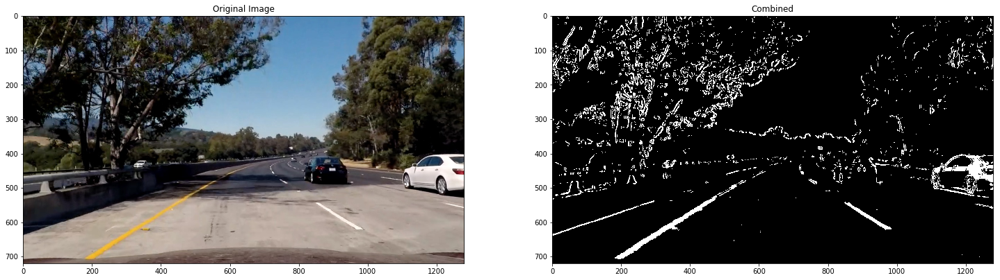

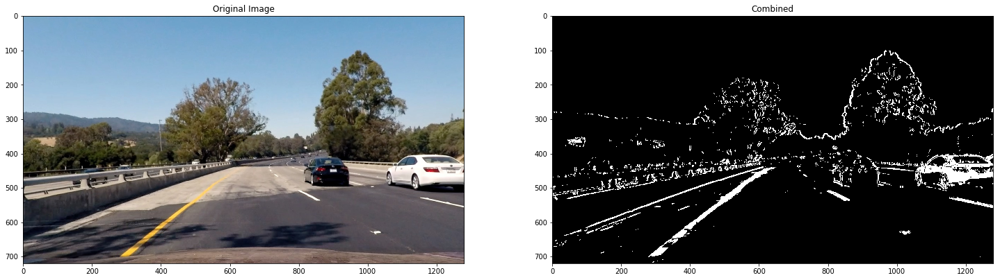

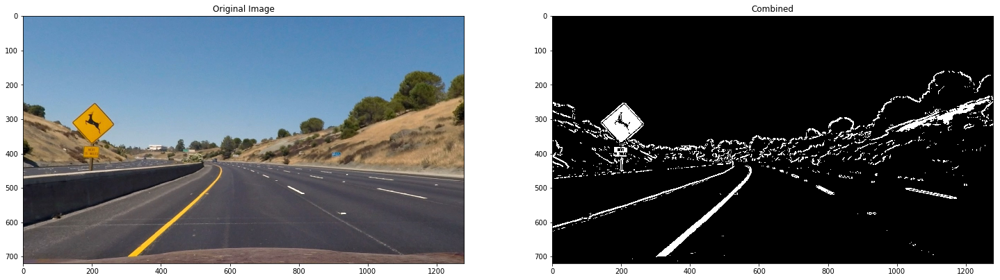

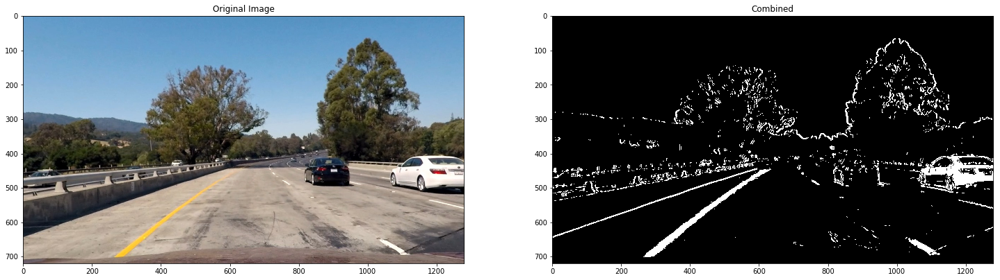

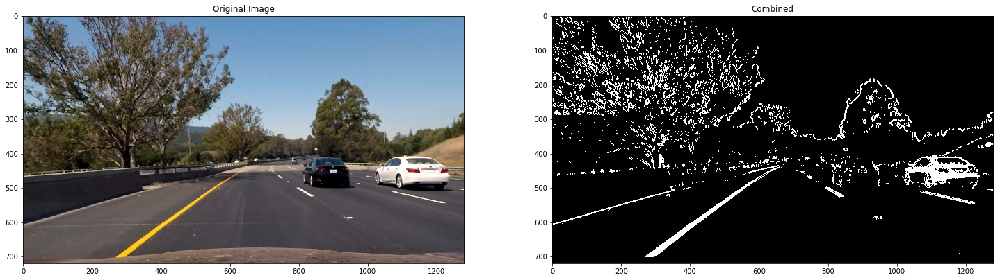

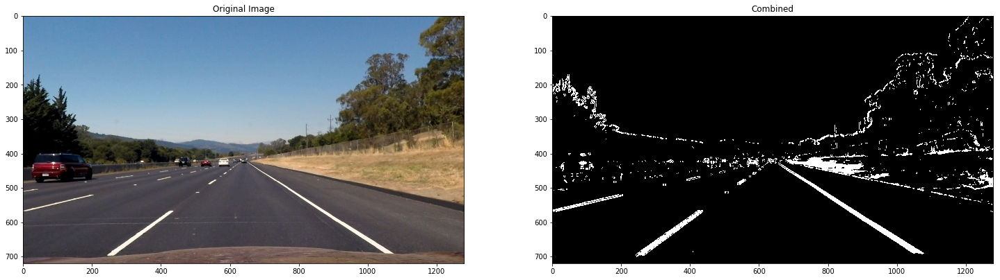

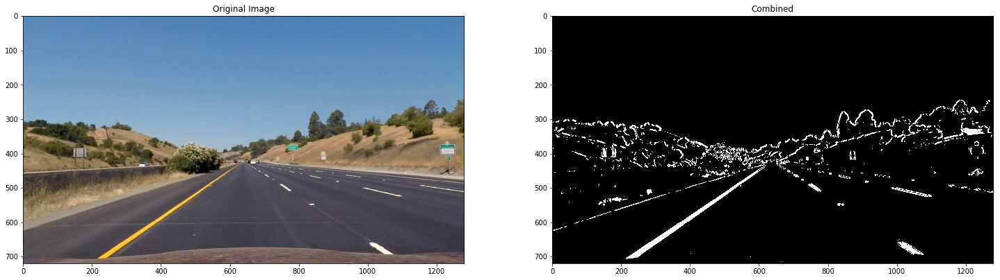

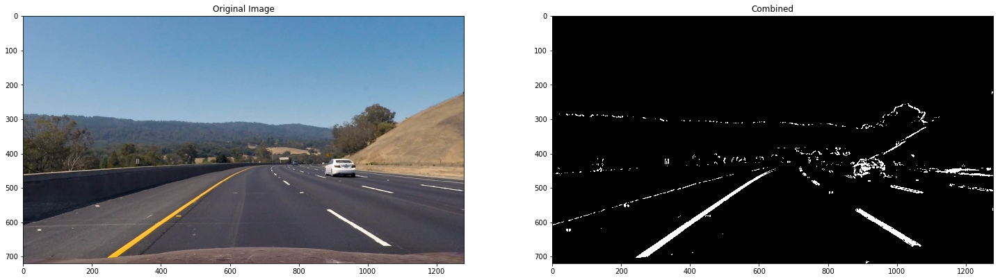

In [15]:
#Thresholding the undistorted image and saving the output to a directory.

undistorted_list = os.listdir(undistorted_dir)

for image_name in undistorted_list:
    img = cv2.imread(undistorted_dir + image_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    binary_output = threshold(img, True)
    save_image(thresholded_dir, image_name, binary_output)

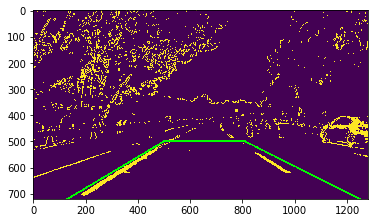

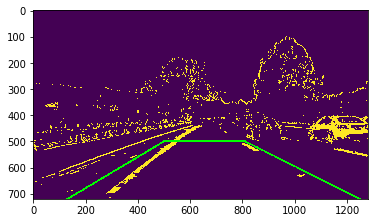

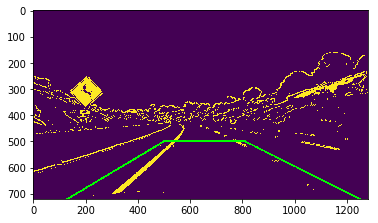

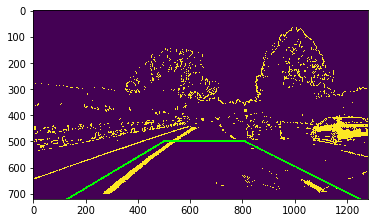

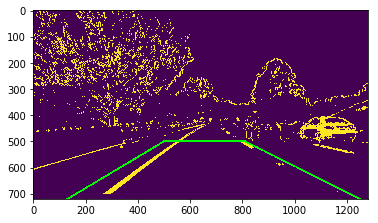

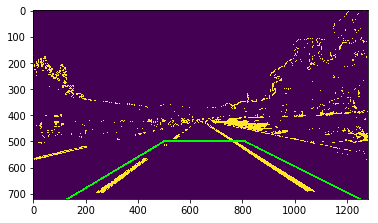

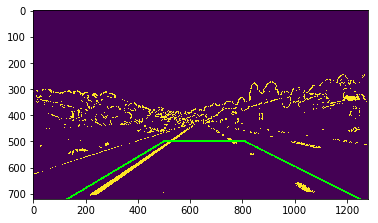

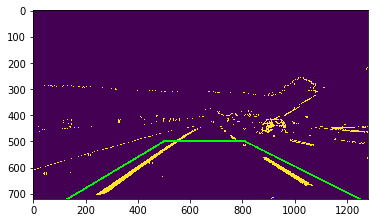

In [16]:
# Region selection for warping of images.

upper_left = (500, 500)
upper_right = (810, 500)
bottom_left = (130, 720)
bottom_right = (1250, 720)

vertices = np.array([[bottom_left, upper_left, upper_right, bottom_right]], np.int32)

thresh_images = os.listdir(thresholded_dir)

for image_name in thresh_images:
    
    a_img = cv2.imread(thresholded_dir + image_name)
    a_img = cv2.cvtColor(a_img, cv2.COLOR_BGR2RGB)

    cv2.polylines(a_img, vertices, False, [0, 255, 0], 5)
    plt.imshow(a_img)
    plt.show()

In [17]:
#Function to warping the image. Function returns warped image and inverse matrix for unwarping as well.

def warping(img, src, dst, show = False):
    M = cv2.getPerspectiveTransform(src, dst)
    
    Minv = cv2.getPerspectiveTransform(dst, src)
    img_size = (img.shape[1], img.shape[0])
    
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    if show == True:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize = (25, 15))
        
        ax1.imshow(img, cmap = "gray")
        ax1.set_title("Lane Image")
        
        ax2.imshow(warped, cmap = "gray")
        ax2.set_title("Warped Image")
    return warped, Minv
    

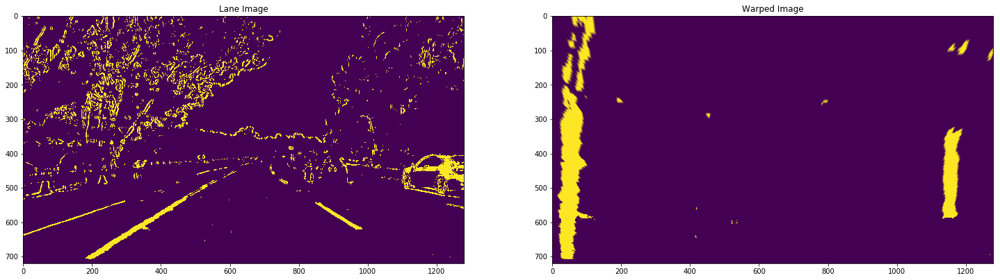

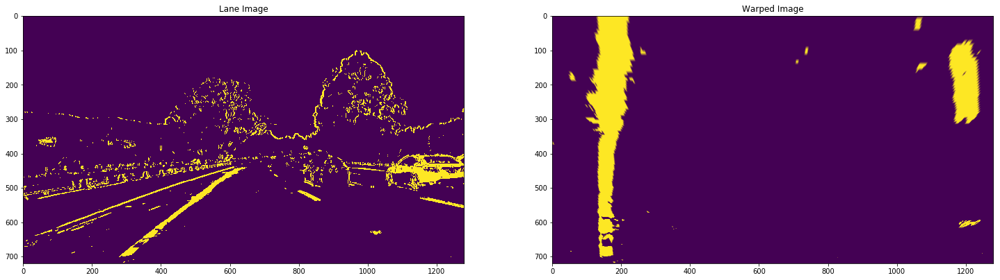

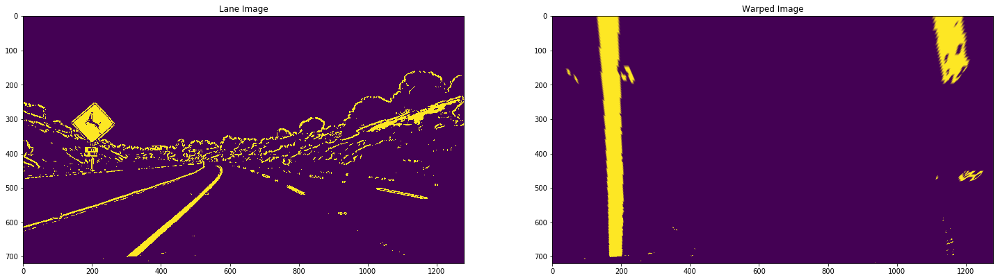

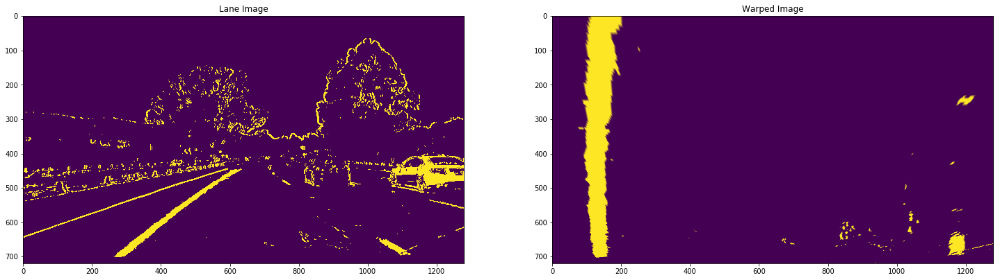

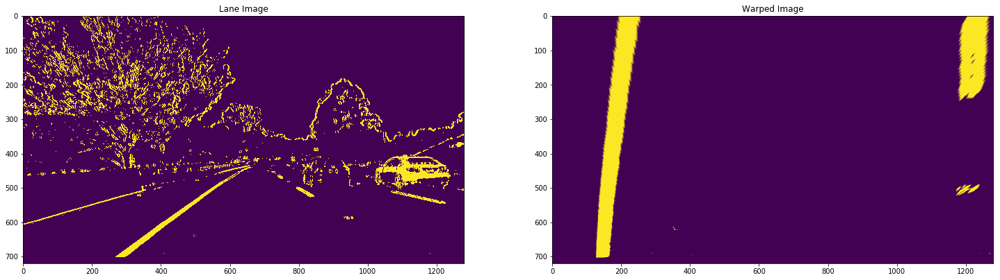

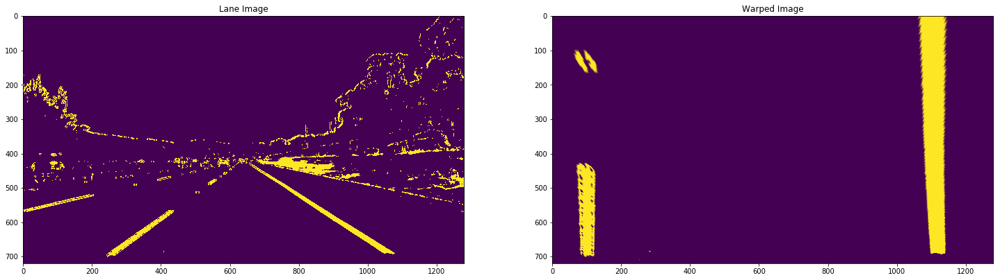

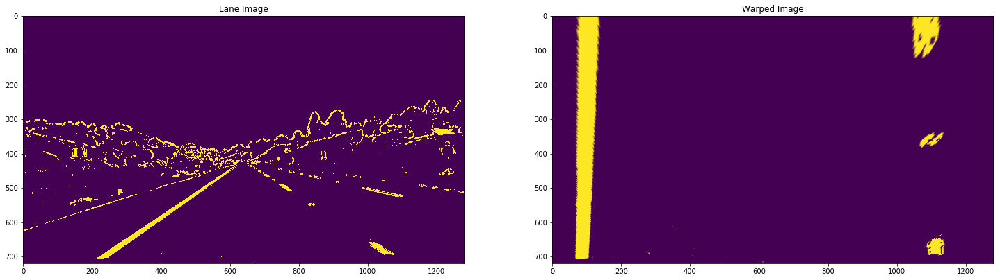

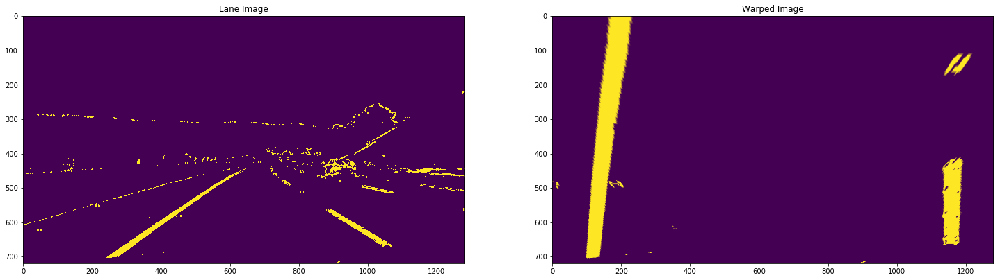

In [18]:
#warping the binary thresholded images and saving the output to a directory.

upper_left = (500, 500)
upper_right = (810, 500)
bottom_left = (130, 720)
bottom_right = (1250, 720)

#upper_left = (575, 455)
#upper_right = (740, 455)
#bottom_left = (130, 720)
#bottom_right = (1250, 720)


src = np.float32([upper_left, upper_right, bottom_left, bottom_right])
dst = np.float32([(0, 0), (1280, 0), (0, 720), (1280, 720)])




thresh_images = os.listdir(thresholded_dir)

for image_name in thresh_images:
    img = cv2.imread(thresholded_dir + image_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    warped_image, Minv = warping(img, src, dst, True)
    save_image(warped_image_dir, image_name, warped_image)

In [19]:
#Function to plot the histogram

def hist(img, show = False):
    # TO-DO: Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    bottom_half = gray[gray.shape[0]//2:, :]
    histogram = np.sum(bottom_half, axis = 0)
    if show == True:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize = (25, 15))
        
        ax1.imshow(gray, cmap = "gray")
        ax1.set_title("Line Image")
        ax2.plot(histogram)
        ax2.set_title("Histogram")
        plt.show()

    
    return histogram

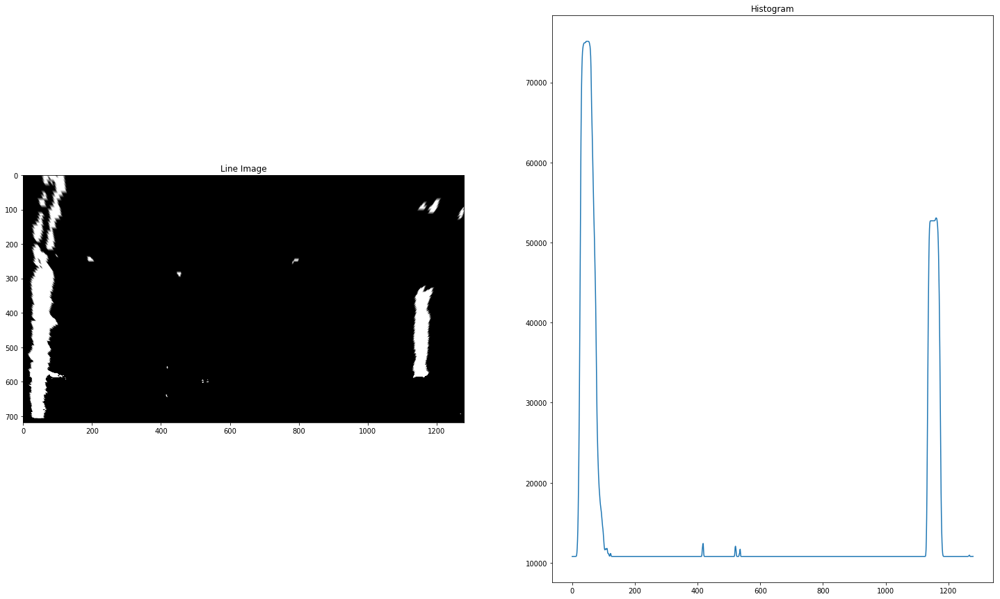

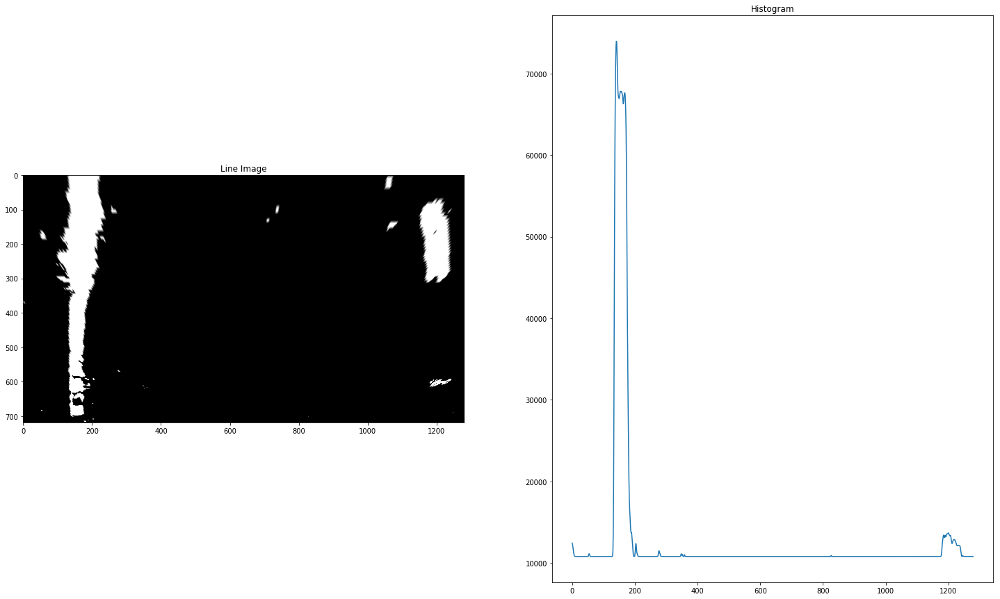

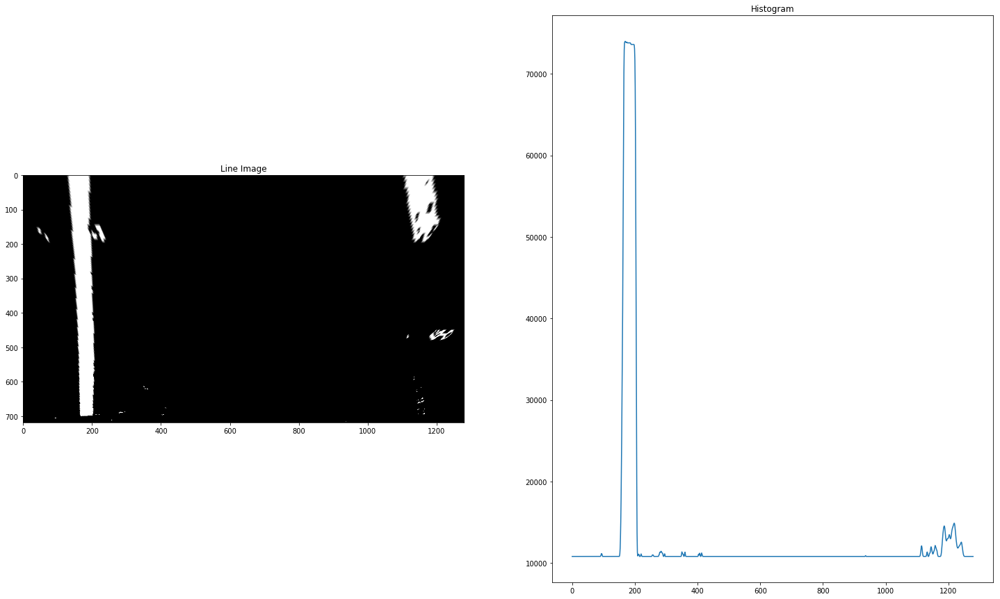

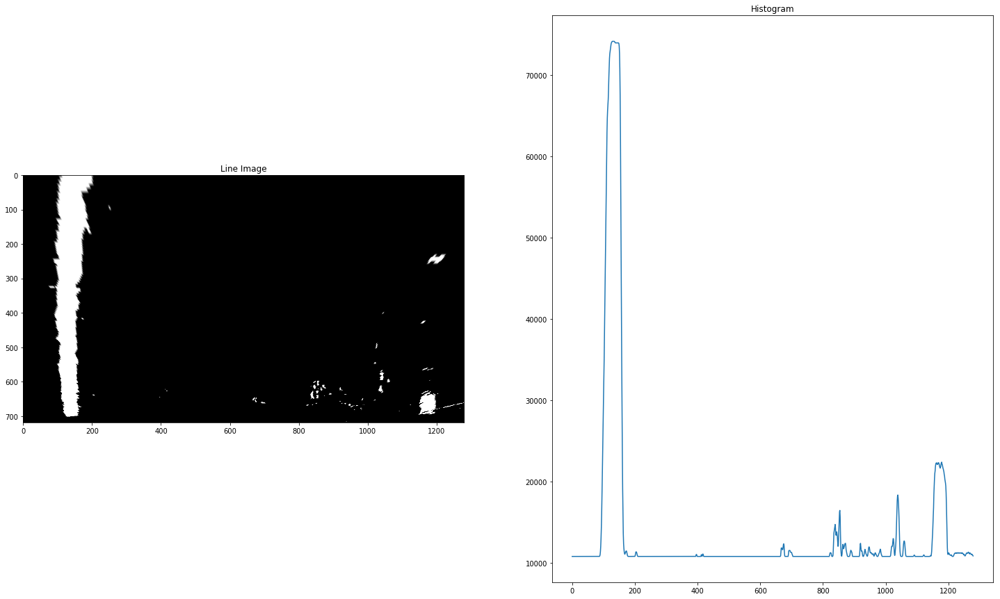

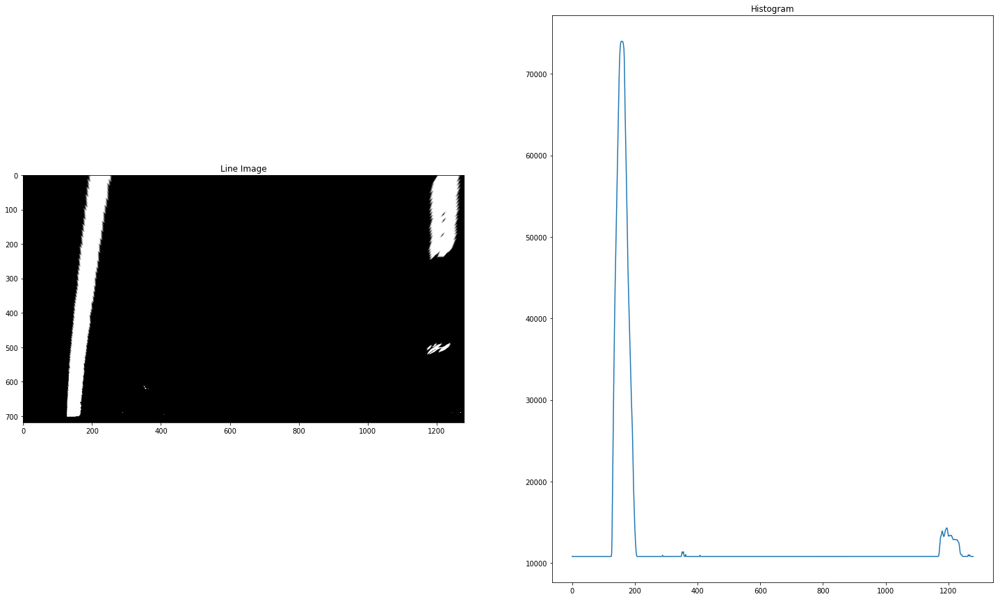

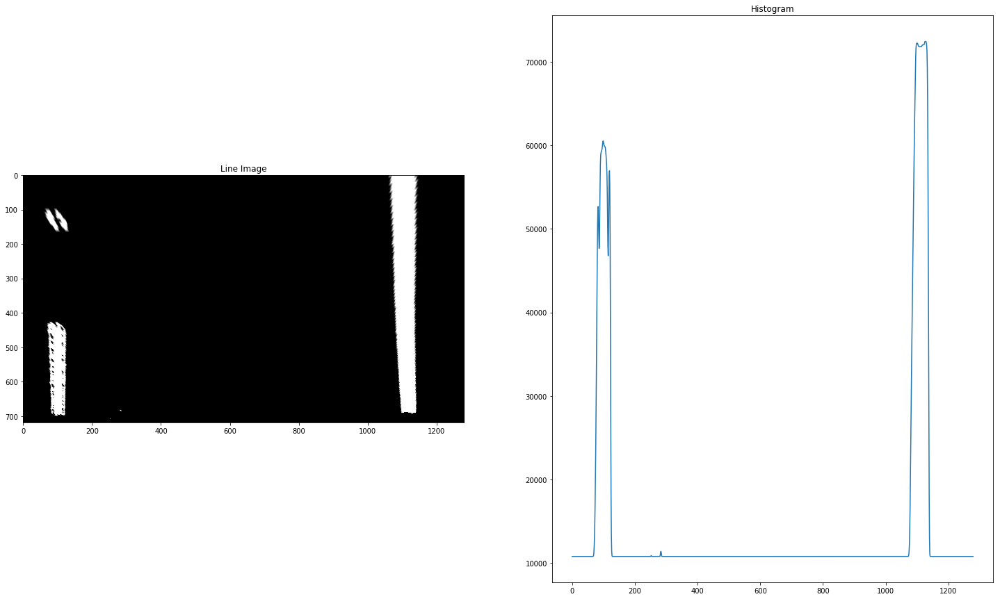

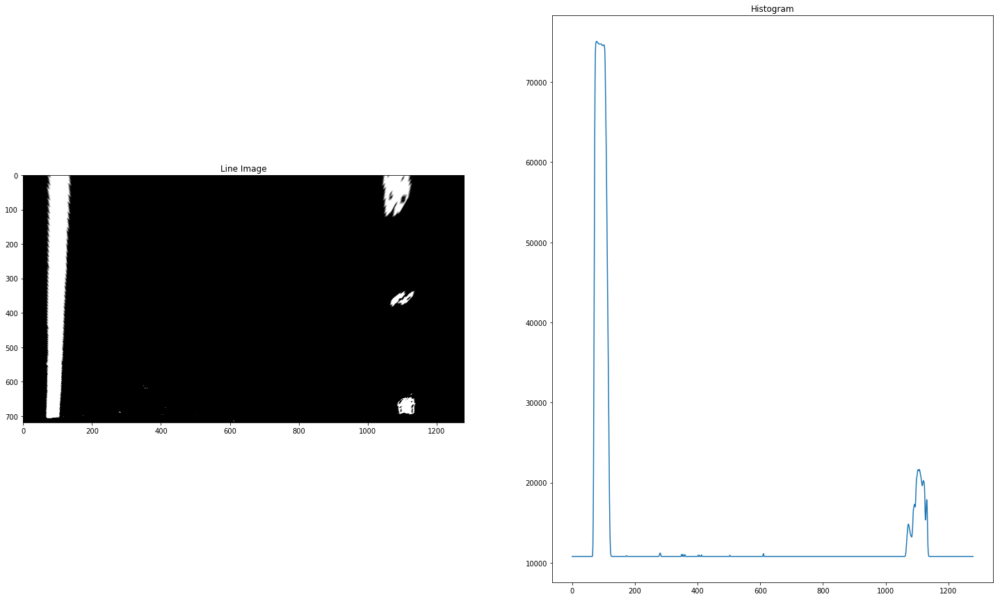

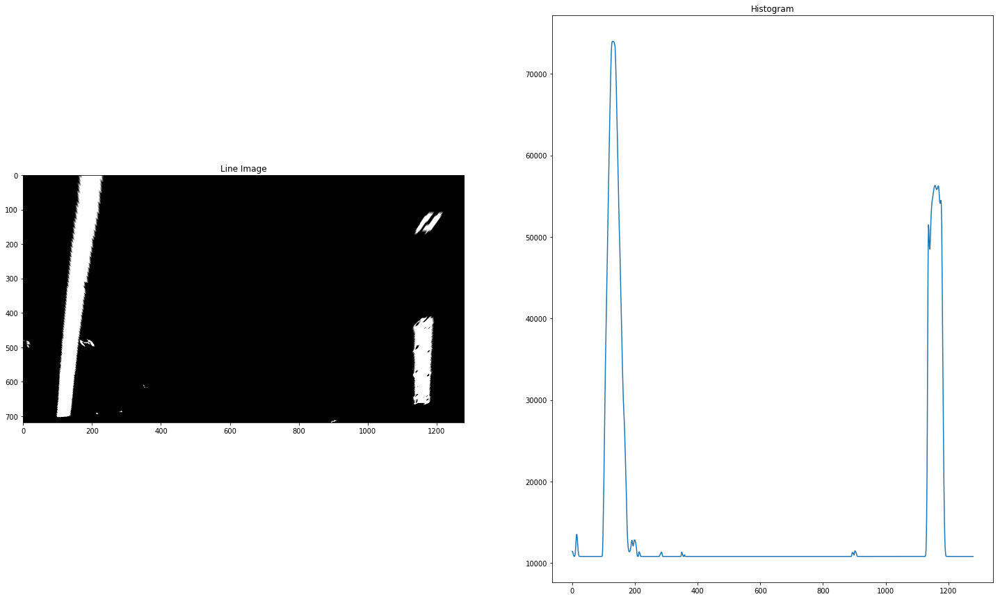

In [20]:
# Plotting the histogram of the warped images for left and right lane lines.

warped_images = os.listdir(warped_image_dir)

for image_name in warped_images:
    img = cv2.imread(warped_image_dir + image_name)
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    histogram = hist(img, True)

In [21]:
# Function to find the lane pixels using histogram and sliding window technique

def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low), (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                          (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                           (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    #try:
    #   left_lane_inds = np.concatenate(left_lane_inds)
    #    right_lane_inds = np.concatenate(right_lane_inds)
    #except ValueError:
    #    # Avoids an error if the above is not implemented fully
    #    pass
    
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    
    return leftx, lefty, rightx, righty, left_fit, right_fit, out_img


In [22]:
# Function to fit the polynomial and get the fit values of x for values of y between 0 to 720.


def fit_polynomial(ploty, left_fit, right_fit, out_img, visuals = False):

    # Generate x and y values for plotting
    #ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    """try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        left_fitx_int = (left_fit[0]*binary_warped.shape[0]**2 + 
                         left_fit[1]*binary_warped.shape[0] + left_fit[2])
        right_fitx_int = (right_fit[0]*binary_warped.shape[0]**2 + 
                          right_fit[1]*binary_warped.shape[0] + right_fit[2])
        
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty
        left_fitx_int = (1*binary_warped.shape[0]**2 + 1*binary_warped.shape[0])
        right_fitx_int = (1*binary_warped.shape[0]**2 + 1*binary_warped.shape[0])"""
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]    
    
    if visuals == True:
        ## Visualization ##
        # Colors in the left and right lane regions
        out_img[lefty, leftx] = [255, 0, 0]
        out_img[righty, rightx] = [0, 0, 255]

        # Plots the left and right polynomials on the lane lines
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')

    return left_fitx, right_fitx, out_img

In [23]:
#Function to calculate the polynomial fit va;ues to calculate radius of curvature.

def find_curv_params(leftx, lefty, rightx, righty, xm_per_pix, ym_per_pix):
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    return left_fit_cr, right_fit_cr

In [24]:
# Function to calculate radius of curvature in meters.

def measure_curvature_real(ploty, left_fit_cr, right_fit_cr, xm_per_pix, ym_per_pix):
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    
    #left_x_curv = left_fit[2] + left_fit[1]*ploty + left_fit[2]*ploty**2
    #right_x_curv = right_fit[2] + right_fit[1]*ploty + right_fit[2]*ploty**2
    
    #left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    #right_fit_cr = np.polyfit(rightx*ym_per_pix, righty*xm_per_pix, 2)
    
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    #print(left_curverad, right_curverad)
    return left_curverad, right_curverad


In [25]:
# Function to calculating x values at y = 720 which is the base of the image.

def calc_intercept(binary_warped, left_fit, right_fit):
    left_fit_intx = left_fit[2] + left_fit[1]*binary_warped.shape[0] + left_fit[0]*binary_warped.shape[0]**2
    right_fit_intx = right_fit[2] + right_fit[1]*binary_warped.shape[0] + right_fit[0]*binary_warped.shape[0]**2
    
    #print(left_fit_intx, right_fit_intx)
    
    return left_fit_intx, right_fit_intx

In [26]:
#Function to fill the lanes.

def filling_lanes(binary_warped, undist, left_fitx, right_fitx, ploty, Minv):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (binary_warped.shape[1], binary_warped.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    return result

In [27]:
# Final lane detection pipeline for images.

def image_pipeline(img):
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    
    undistorted_image = undistort(img, mtx, dist)
    binary_output = threshold(undistorted_image)
    binary_warped, Minv = warping(binary_output, src, dst)
    
    leftx, lefty, rightx, righty, left_fit, right_fit, out_img = find_lane_pixels(binary_warped)
    
    left_fitx, right_fitx, out_img = fit_polynomial(ploty, left_fit, right_fit, out_img)
    
    left_fit_cr, right_fit_cr = find_curv_params(leftx, lefty, rightx, righty, xm_per_pix, ym_per_pix)
    left_curverad, right_curverad = measure_curvature_real(ploty, left_fit_cr, right_fit_cr, xm_per_pix, ym_per_pix)

    
    left_fit_intx, right_fit_intx = calc_intercept(binary_warped, left_fit, right_fit)


    
    result = filling_lanes(binary_warped, undistorted_image, left_fitx, right_fitx, ploty, Minv)
    #left_curverad, right_curverad = measure_curvature_real(ploty, left_fit_cr, right_fit_cr)
    
    lane_center = img.shape[1]/2
    vehicle_pos_from_center = lane_center - (left_fit_intx + right_fit_intx)/2
    
    
    if vehicle_pos_from_center > 0:
        pos_text = 'Vehicle is {:.2f}m left of center'.format(abs(vehicle_pos_from_center)*3.7/700)
    elif vehicle_pos_from_center < 0:
        pos_text = 'Vehicle is {:.2f}m right of center'.format(abs(vehicle_pos_from_center)*3.7/700)
    else:
        pos_text = 'Vehicle is at the center of the lane'
        
    left_curv_text = 'Radius of curvature left lane is {}m'.format(int(left_curverad))
    right_curv_text = 'Radius of curvature right lane is {}m'.format(int(right_curverad))
    
    cv2.putText(result, pos_text, (150, 50), cv2.FONT_HERSHEY_PLAIN, 3, (255,255,255), 4, cv2.LINE_AA)
    cv2.putText(result, left_curv_text, (150, 100), cv2.FONT_HERSHEY_PLAIN, 3, (255,255,255), 4, cv2.LINE_AA)
    cv2.putText(result, right_curv_text, (150, 150), cv2.FONT_HERSHEY_PLAIN, 3, (255,255,255), 4, cv2.LINE_AA)
    
    
    
    return result

    

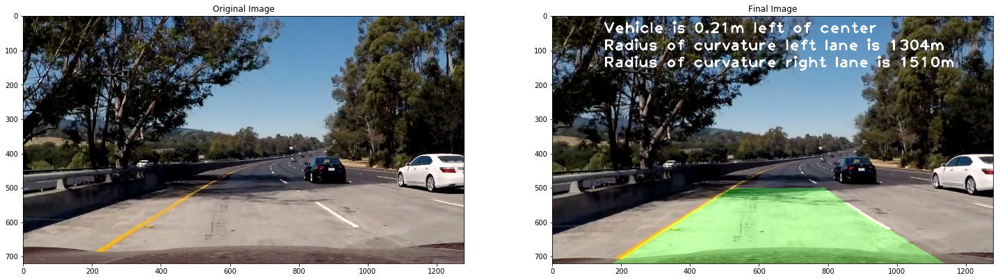

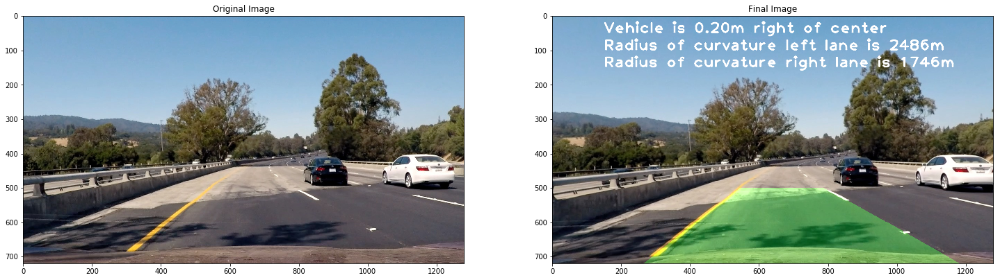

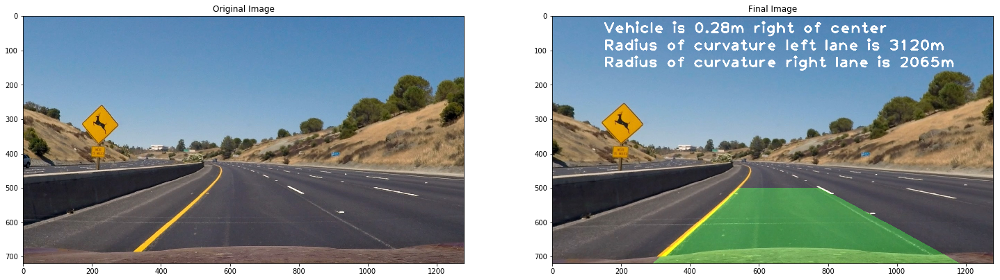

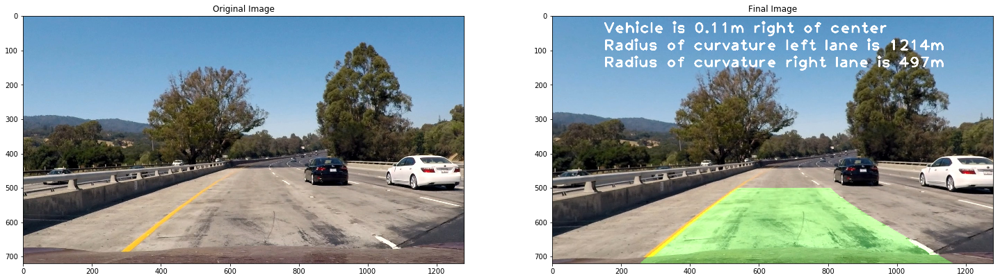

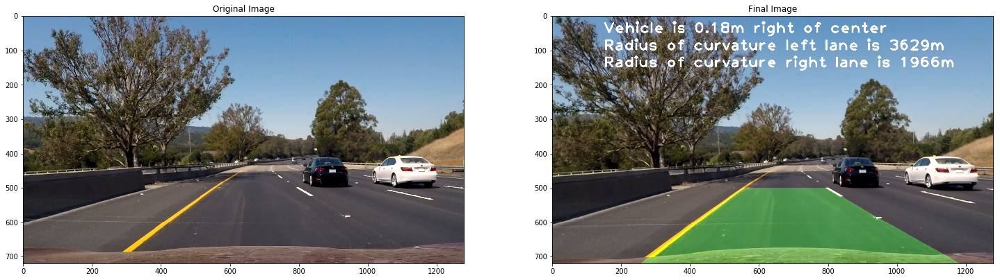

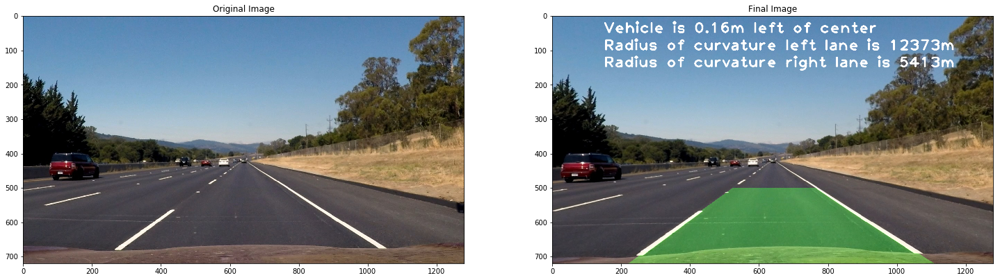

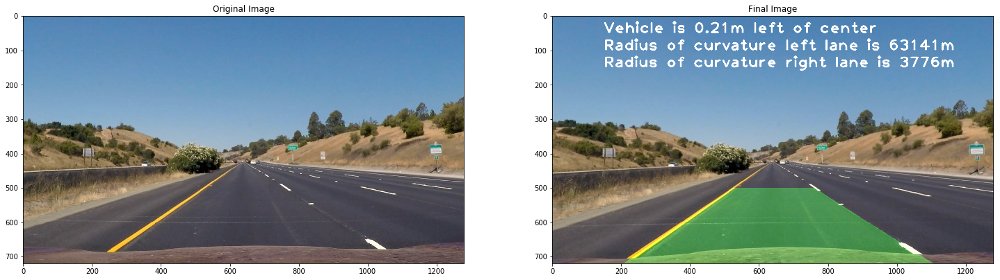

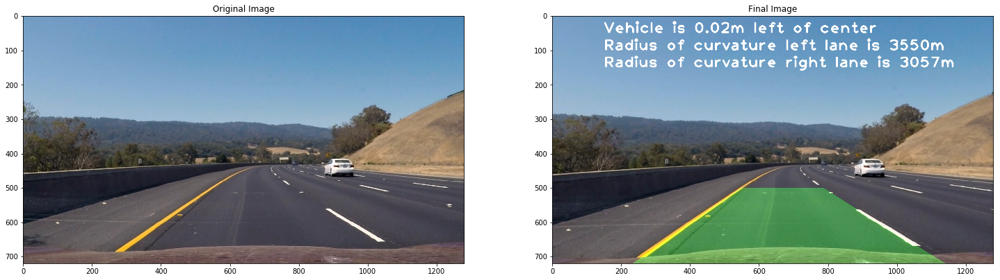

In [28]:
# Implementing the image pipeline on the test images and saving the images to a directory


for test_image in test_images:
    img = cv2.imread(test_image_dir + test_image)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    result = image_pipeline(img)
    save_image(test_output_dir, test_image, result)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize = (25, 15))
    
    ax1.imshow(img)
    ax1.set_title("Original Image")
    
    
    ax2.imshow(result)
    ax2.set_title("Final Image")
    
    
    

In [29]:
#Plotting the sliding window images as required in project rubric


import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2


def find_lane_pixels_plot(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 4) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 4) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial_plot(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels_plot(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img

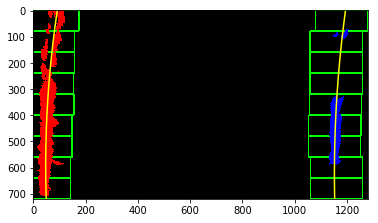

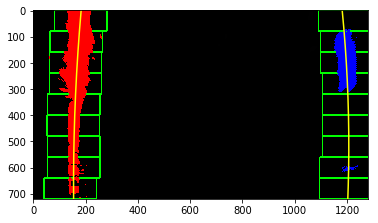

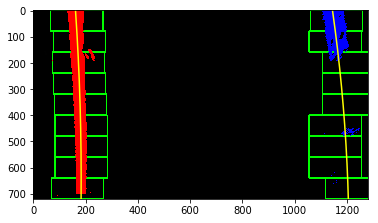

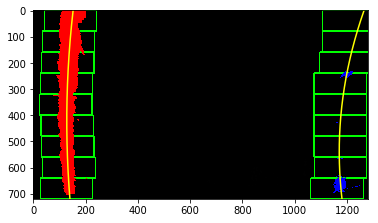

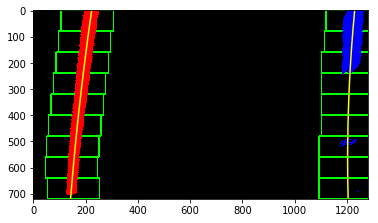

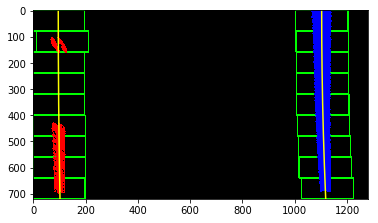

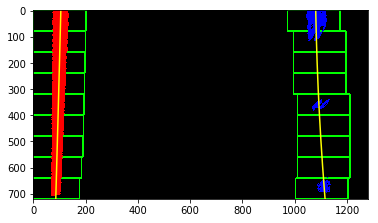

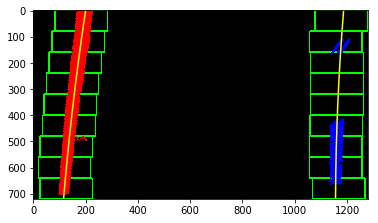

In [30]:
for image_name in test_images:
    

    img = cv2.imread(test_image_dir + image_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


    #Setting the various parameters used within the pipeline.
    upper_left = (500, 500)
    upper_right = (810, 500)
    bottom_left = (130, 720)
    bottom_right = (1250, 720)

    #upper_left = (575, 455)
    #upper_right = (740, 455)
    #bottom_left = (130, 720)
    #bottom_right = (1250, 720)

    src = np.float32([upper_left, upper_right, bottom_left, bottom_right])
    dst = np.float32([(0, 0), (1280, 0), (0, 720), (1280, 720)])

    minpix = 50

    #src = np.float32([upper_left, upper_right, bottom_left, bottom_right])
    #dst = np.float32([(320, 0), (1280, 0), (0, 720), (960, 720)])

    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )

    #undistorting the image.
    undistorted_image =  undistort(img, mtx, dist)

    #applyting thresholds to get the lane detected binary image.
    binary_output = threshold(undistorted_image)

    #warping of the image and getting inverse matrix as well for unwarping.
    binary_warped, Minv = warping(binary_output, src, dst)

    out_img = fit_polynomial_plot(binary_warped=binary_warped)
    save_image(sliding_window_dir, image_name, out_img)
    plt.imshow(out_img)
    plt.show()

In [31]:
# One more thresholding function which is only using red color from RGB color space and saturation from the HLS color space. 

def video_threshold(img, show = False):
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    x_sobel = abs_sobel_thresh(img, orient='x', sobel_kernel = 15, thresh = (20, 150))
    y_sobel = abs_sobel_thresh(img, orient='y', sobel_kernel = 3, thresh = (20, 150))
    mag_sobel = mag_thresh(img, sobel_kernel = 9, thresh = (50, 255))
    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    R_thresh = (200, 255)
    S_thresh = (90, 255)
    
    R = img[:, :, 0]
    G = img[:, :, 1]
    B = img[:, :, 2]
    binary_r = np.zeros_like(R)
    binary_r[(R >= R_thresh[0]) & (R <= R_thresh[1])] = 1
    
    
    H = hls[:, :, 0]
    L = hls[:, :, 1]
    S = hls[:, :, 2]
    binary_s = np.zeros_like(S)
    binary_s[(S >= S_thresh[0]) & (S <= S_thresh[1])] = 1
    
    binary_sobel = np.zeros_like(y_sobel)
    binary_sobel[(x_sobel == 1) & (mag_sobel == 1)]=1
    
    binary_color = np.zeros_like(R)
    binary_color[(binary_r == 1) | (binary_s == 1)] = 1
    
    binary_output = np.zeros_like(R)
    binary_output[(binary_sobel == 1) | (binary_color == 1)] = 1
    
    if show == True:
        
        #f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize = (25, 20))
        f, (ax1, ax2) = plt.subplots(1, 2, figsize = (25, 20))

        ax1.imshow(img, cmap = "gray")
        ax1.set_title("Original Image")

        ax2.imshow(binary_output, cmap = "gray")
        ax2.set_title("Combined")

        #ax3.imshow(binary, cmap = "gray")
        #ax3.set_title("Mag thresh")
    return binary_color

In [32]:
# Defining the class for the Lane.

class Lane():
    def __init__(self):
        self.proper = False
        self.left_fit = None
        self.n_left_fit = collections.deque(maxlen = 10)
        
        self.right_fit = None
        self.n_right_fit = collections.deque(maxlen = 10)
        
        self.left_x = None
        self.left_y = None
        self.right_x = None
        self.right_y = None
        
        
        
        self.invalid_frame_counts = 0
        
        self.frame_counts = 0
        
        self.best_left_fit = None
        self.best_right_fit = None
        
        self.vehicle_position = None
        
        self.left_fitx = None
        self.right_fitx = None
        
        self.best_left_fitx = None
        self.best_right_fitx = None
        
        self.left_radius = None
        self.right_radius = None

In [33]:
# Histogram and sliding window technique for lane detection.

def video_find_lane_pixels_1(binary_warped, visual = False):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low), (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)


    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    if len(leftx) == 0:
        left_fit = []
        #print("left is 0")
    else:
        left_fit = np.polyfit(lefty, leftx, 2)
        
    if len(rightx) == 0:
        right_fit = []
        #print("right is 0")
    else:
        right_fit = np.polyfit(righty, rightx, 2)
        
    # Generate x and y values for plotting
    if (len(left_fit) != 0) & (len(right_fit) != 0):
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )

        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    
    if visual == True:
        
        ## Visualization ##
        # Colors in the left and right lane regions
        out_img[lefty, leftx] = [255, 0, 0]
        out_img[righty, rightx] = [0, 0, 255]

        # Plots the left and right polynomials on the lane lines
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')

    return left_fit, right_fit, out_img, leftx, lefty, rightx, righty




In [34]:
#Calculating the fitted x values from the y values using the polynomial coefficients.

def calculate_fitx(binary_warped, left_fit, right_fit):
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )

    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty

In [35]:
# Function to search lane lines in the window set by previous fit with the margin.

def video_search_around_poly_1(binary_warped, left_fit, right_fit, visual = False):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    if len(leftx) == 0:
        left_fit = []
    else:
        left_fit = np.polyfit(lefty, leftx, 2)
    
    if len(rightx) == 0:
        right_fit = []
    else:
        right_fit = np.polyfit(righty, rightx, 2)
        
    if (len(left_fit) != 0) & (len(right_fit) != 0):
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )

        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    if visual == True:
        
        ## Visualization ##
        # Create an image to draw on and an image to show the selection window
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
        window_img = np.zeros_like(out_img)
        # Color in left and right line pixels
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

        # Generate a polygon to illustrate the search window area
        # And recast the x and y points into usable format for cv2.fillPoly()
        left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
        left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                  ploty])))])
        left_line_pts = np.hstack((left_line_window1, left_line_window2))
        right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
        right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                  ploty])))])
        right_line_pts = np.hstack((right_line_window1, right_line_window2))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
        cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
        result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

        # Plot the polynomial lines onto the image
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        ## End visualization steps ##
    
    return left_fit, right_fit, leftx, lefty, rightx, righty

In [36]:
# Function to measure radius of curvatures.

def measure_curvature_real(left_fitx, right_fitx, ploty, xm_per_pix, ym_per_pix):
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return left_curverad, right_curverad

In [37]:
#Function to calculate the vehicle position in pixels.

def calc_vehicle_position(binary_warped, left_fit, right_fit):
    left_intercept = left_fit[2] + left_fit[1]*binary_warped.shape[0] + left_fit[0]*binary_warped.shape[0]**2
    right_intercept = right_fit[2] + right_fit[1]*binary_warped.shape[0] + right_fit[0]*binary_warped.shape[0]**2
    center = binary_warped.shape[1]/2
    vehicle_position = center - (left_intercept + right_intercept)/2
    return vehicle_position

In [38]:
# Function to fill the detected lane lines.

def filling_lanes(binary_warped, undist, left_fitx, right_fitx, ploty, Minv):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (binary_warped.shape[1], binary_warped.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    return result

In [39]:
#Function to check whether the lane is proper or not.

def lane_proper_test(binary_warped, left_fit, right_fit,xm_per_pix):
    
    #check if any of the left_fit or right_fit is with length = 0
    if (len(left_fit) == 0) | (len(right_fit) == 0):
        proper = False
        return proper
    else:
        proper = True
        
    #check left and right lanes are parallel or not
    # Find slope of the lines at middle of the image
    left_slope = 2*binary_warped.shape[0]//2*left_fit[0] + left_fit[1]
    right_slope = 2*binary_warped.shape[0]//2*right_fit[0] + right_fit[1]
    if np.abs(left_slope - right_slope) > 0.1:
        proper = False
        return proper
    else:
        proper = True
        
    # vehicle position check
    vehicle_position = calc_vehicle_position(binary_warped, left_fit, right_fit)
    vehicle_position_real = np.abs(vehicle_position)*xm_per_pix
    
    if vehicle_position_real > 0.5:
        proper = False
        return proper
    else:
        proper = True
        
    return proper
            
    

In [40]:
# Function to calculate the x values fitted from the y values using the polynomial coefficients.

def calc_fit_x(left_fit, right_fit, ploty):
    #ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )

    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx

In [41]:
# Main video lane detection pipeline


def video_pipeline_main(img):
    
    #Setting the various parameters used within the pipeline.
    upper_left = (500, 500)
    upper_right = (810, 500)
    bottom_left = (130, 720)
    bottom_right = (1250, 720)
    
    #upper_left = (575, 455)
    #upper_right = (740, 455)
    #bottom_left = (130, 720)
    #bottom_right = (1250, 720)

    src = np.float32([upper_left, upper_right, bottom_left, bottom_right])
    dst = np.float32([(0, 0), (1280, 0), (0, 720), (1280, 720)])

    minpix = 50

    #src = np.float32([upper_left, upper_right, bottom_left, bottom_right])
    #dst = np.float32([(320, 0), (1280, 0), (0, 720), (960, 720)])
    
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    
    #undistorting the image.
    undistorted_image =  undistort(img, mtx, dist)
    
    #applyting thresholds to get the lane detected binary image.
    binary_output = threshold(undistorted_image)
    
    #warping of the image and getting inverse matrix as well for unwarping.
    binary_warped, Minv = warping(binary_output, src, dst)
    
    # Start with histogram and sliding window search to get the fit and 
    #set the boundaries for search around for first frame.
    if lane.frame_counts == 0:
        lane.left_fit, lane.right_fit, histogram_image, lane.left_x, lane.left_y, lane.right_x, lane.right_y = \
        video_find_lane_pixels_1(binary_warped)
        lane.proper == True
    
    # apply the sliding window search or search around as per validity of the lanes.
    # if lane is proper then search around will be used and if lane in improper then histogram sliding window search
    # will be used.
    else:
        if lane.proper == True:
            lane.left_fit, lane.right_fit, lane.left_x, lane.left_y, lane.right_x, lane.right_y = \
            video_search_around_poly_1(binary_warped, lane.n_left_fit[-1], lane.n_right_fit[-1])
        else:
            lane.left_fit, lane.right_fit, histogram_image, lane.left_x, lane.left_y, lane.right_x, lane.right_y = \
            video_find_lane_pixels_1(binary_warped)
            
        
        
    lane.proper = lane_proper_test(binary_warped, lane.left_fit, lane.right_fit, xm_per_pix)   
    
    #print(lane.proper)
    
    # If lanes are proper then new values of fit will be appended to the the list of n fits
    # New values of right and left fit values of x are calculated.
    if lane.proper == True:
        lane.n_left_fit.append(lane.left_fit)
        lane.n_right_fit.append(lane.right_fit)
        lane.left_fitx, lane.right_fitx, ploty = calculate_fitx(binary_warped, lane.left_fit, lane.right_fit)
    
    #print(lane.n_left_fit, lane.n_right_fit)
    
    # Taking the mean of the n fits to get the average of the fits.
    lane.best_left_fit = np.mean(lane.n_left_fit, axis = 0)
    lane.best_right_fit = np.mean(lane.n_right_fit, axis = 0)
    #print(lane.best_left_fit, lane.best_right_fit)
    
    # Calculating the best values of x by fitting on best fit.
    lane.best_left_fitx, lane.best_right_fitx = calc_fit_x(lane.best_left_fit, lane.best_right_fit, ploty) 
        

    
    # Calculating the radius of curvature
    lane.left_radius, lane.right_radius = measure_curvature_real(lane.best_left_fitx, 
                                                                 lane.best_right_fitx, ploty, xm_per_pix, ym_per_pix)
    
    
    # Increase the frame count value.
    lane.frame_counts += 1
    
    #out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    #out_img[lane.left_y, lane.left_x] = [255, 0, 0]
    #out_img[lane.right_y, lane.right_x] = [0, 0, 255]
    
    
    # Saving the result of filled lanes.
    result = filling_lanes(binary_warped, undistorted_image, lane.best_left_fitx, lane.best_right_fitx, ploty, Minv)
    
    #plt.imshow(out_img)
    #plt.show()
    
    # Calculating the vehicle position on the lane.
    lane.vehicle_position = calc_vehicle_position(binary_warped, lane.n_left_fit[-1], lane.n_right_fit[-1])
    
    #putting the position of the vehicle on the lane as per calculated vehicle position.
    if lane.vehicle_position > 0:
        pos_text = 'Vehicle is {:.2f}m left of center'.format(abs(lane.vehicle_position)*3.7/700)
    elif lane.vehicle_position < 0:
        pos_text = 'Vehicle is {:.2f}m right of center'.format(abs(lane.vehicle_position)*3.7/700)
    else:
        pos_text = 'Vehicle is at the center of the lane'
    
    # Creating the left and right lane radius of curvature text.
    left_curv_text = 'Radius of curvature left lane is {}m'.format(int(lane.left_radius))
    right_curv_text = 'Radius of curvature right lane is {}m'.format(int(lane.right_radius))
    
    
    # Embedding the vehicle position and radius of curvature text on the image
    cv2.putText(result, pos_text, (150, 50), cv2.FONT_HERSHEY_PLAIN, 3, (255,255,255), 4, cv2.LINE_AA)
    cv2.putText(result, left_curv_text, (150, 100), cv2.FONT_HERSHEY_PLAIN, 3, (255,255,255), 4, cv2.LINE_AA)
    cv2.putText(result, right_curv_text, (150, 150), cv2.FONT_HERSHEY_PLAIN, 3, (255,255,255), 4, cv2.LINE_AA)
    
    
    #out = np.zeros_like(result, dtype=np.uint8)
    
    #out = np.dstack((binary_warped*255, binary_warped*255, binary_warped*255))
    
    #out[:, 0:640, :] = cv2.resize(result, (640, 720))
    #out[:360, 640:, 0] = cv2.resize(binary_warped*255, (640, 360))
    #out[:360, 640:, 1] = cv2.resize(binary_warped*255, (640, 360))
    #out[:360, 640:, 2] = cv2.resize(binary_warped*255, (640, 360))
    #out[360:, 640:, :] = cv2.resize(out_img, (640, 360))
    
    #return out
    return result

        

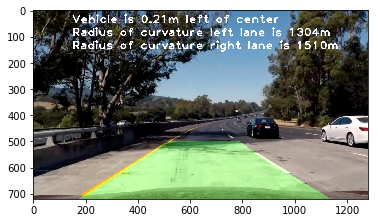

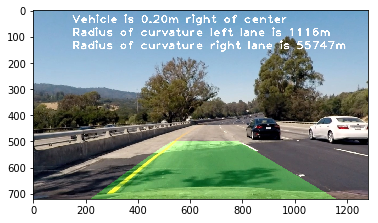

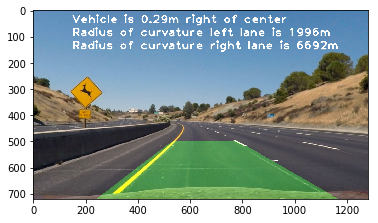

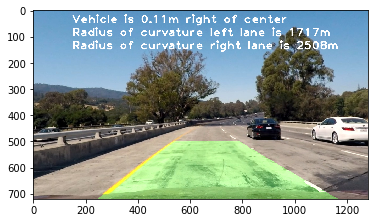

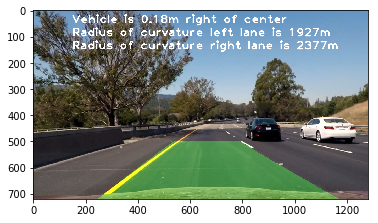

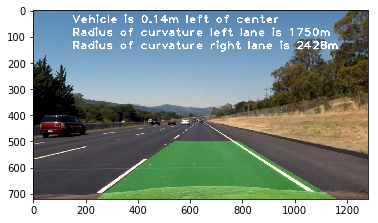

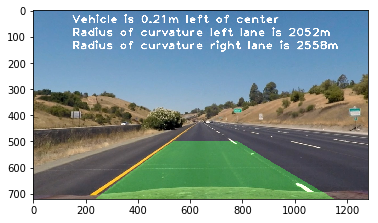

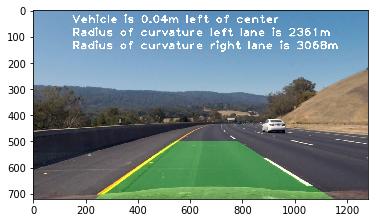

In [42]:
# Testing the video pipeline first on test images.

lane = Lane()

for image_name in test_images:
    image = cv2.imread(test_image_dir + image_name)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    result = video_pipeline_main(image)
    
    plt.imshow(result)
    plt.show()


In [43]:
# Applying video lane detection pipeline on project video

lane = Lane()

project_video_output = 'project_video_output.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("challenge_video.mp4").subclip(0, 10)
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(video_pipeline_main) #NOTE: this function expects color images!!
%time white_clip.write_videofile(project_video_output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [08:24<00:00,  2.59it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 6min 6s, sys: 2.75 s, total: 6min 9s
Wall time: 8min 27s


In [45]:
HTML("""
<video width="960" height="480" controls>
  <source src="{0}">
</video>
""".format(project_video_output))

## Project writeup for Advance lane detection


---

**Advanced Lane Finding Project**

The steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

[//]: # (Image References)

[image1]: ./camera_cal/calibration1.jpg "Distorted chessboard"
[image2]: ./camera_cal_undistort/calibration1.jpg "Undistorted Chessboard"
[image3]: ./test_images_undistort/straight_lines1.jpg "Undistorted test image"
[image4]: ./test_images_threshold/straight_lines1.jpg "Threshold Binary"
[image5]: ./test_images_warped/straight_lines1.jpg "Warped"
[image6]: ./test_images_output/straight_lines1.jpg "Final Output"
[image7]: ./test_images/straight_lines1.jpg "Distorted test image"
[image8]: ./test_images_sliding/straight_lines1.jpg "Sliding window"
[video1]: ./project_video_output.mp4 "Video"



### Camera Calibration

#### 1. Briefly state how you computed the camera matrix and distortion coefficients. Provide an example of a distortion corrected calibration image.

This is the first step in advance lane detection. Lenses in cameras introduce distortion in the images which is called radial distortion. Images need to be undistorted. This step involves following substeps. 

1. Creation of object points which is 3D representation of image and image points which is 2D representation. This is done by using the chessboard images. **cv2.findChessboardCorners()** is used for finding the inner corners in the chessboard image and then those corners act as image points and we have object points as well. We can draw corners on chessboard images using **cv2.drawChessboardCorners()** function.

2. Then **cv2.calibrateCamera()** function is used to calculate the camera matrix, distortion coefficients and other coefficients and camera matrix and distortion coefficients are used to undistort the image.

3. Then **cv2.undistort()** function uses matrix and distortion coefficients to give the undistorted image. Following is the examples of distorted and undistorted images.

![Distorted_image][image1]



![Undistorted_image][image2]

### Pipeline (single images)

#### 1. Provide an example of a distortion-corrected image.

Following is the input test image and distortion corrected image which has been obtained by applying the undistortion steps.


![Distorted_test_image][image7]


![Undistorted_test_image][image3]


#### 2. Describe how (and identify where in your code) you used color transforms, gradients or other methods to create a thresholded binary image.  Provide an example of a binary image result.

Next step is to get the thresholded binary image which is like Canny detection of edges but this uses various color spaces and sobel functions.

This is one of the most important part in the lane detection as this decides how lanes are detected.

We have various functions like **x and y sobel, magnitude sobel, direction sobel** as various gradient methods.

We can apply various thresholds on various components of color spaces like RGB, HLS, etc color spaces.

1. x sobel : This emphasizes edges closer to vertical axis.

2. y sobel : This emphasizes edges closer to hosrizontal axis.

3. Magnitude sobel : This works on magnitude and use both x and y sobel.

4. Direction sobel : This uses arctan function and gives direction. 0 implies vertical line and +/- 90 degrees denotes horizontal line.

5. Color spaces : We have various color spaces and I tried to use RGB and HLS color spaces.

I tried various thresholds of above mentiones thresholds and finally settled on using X and magnitude sobel along with thresholded R from RGB and S from HLS color spaces.

Function **threshold()** is being created for thresholding.

Following is the image representing the tresholded binary image.





#### 3. Describe how (and identify where in your code) you performed a perspective transform and provide an example of a transformed image.

After thresholded image, next step is to perform the perspective transform. Perspective transform gives bird eye view of the lanes detected in thresholded binary image.

I have created function **warping()** for this which returns perspetive transformed image as well as inverse matrix for inverse perspective transform and used following values after going through the process similar to the region selection.
Following values have been used for perspective transformation. 



| Source        | Destination   | 
|:-------------:|:-------------:| 
| 500, 500      | 0, 0          | 
| 810, 500      | 1280, 0       |
| 130, 720      | 0, 720        |
| 1250,720      | 1280, 720     |

I verified that my perspective transform was working as expected by drawing the `src` and `dst` points onto a test image and its warped counterpart to verify that the lines appear parallel in the warped image.

![Warped_image][image5]

#### 4. Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?

After perspective transform, I used histogram sliding window technique to fit a second order polynomial. In this method image is divided into 2 halves, right and left respectively, for right and left lanes and both the halves are scanned in smaller windows which is a hyperparameter and window width is given by a configurable hyperparameter.

Following image describes the sliding window approach to fit polynomial.

![Sliding_window][image8]

#### 5. Describe how (and identify where in your code) you calculated the radius of curvature of the lane and the position of the vehicle with respect to center.

Radius of curvature has been calculated by formula given at [Radius of curvature](https://www.intmath.com/applications-differentiation/8-radius-curvature.php). Basic idea is to find the radius of curvature of the curve at a particular point is defined as the radius of the approximating circle.

So derivation was required but second order polynomial derivative is the slope of the line.

Function **measure_curvature_real()** is used for this purpose.



#### 6. Provide an example image of your result plotted back down onto the road such that the lane area is identified clearly.

Plotting lanes and filling the lane lines requires inverse persepective transform and then filling the polynomial between both the lane lines.

Inverse perspective transform requires Inverse matrix which can be calculated by just reversing the **src and dst** in the function **cv2.getPerspectiveTransform()** and then using the **cv2.warpPerspective()** in the similar way as perspective transform was found.

![Final_output][image6]

---

### Pipeline (video)

#### 1. Provide a link to your final video output.  Your pipeline should perform reasonably well on the entire project video (wobbly lines are ok but no catastrophic failures that would cause the car to drive off the road!).

Following is the link of my project video.

[Video](./project_video_output.mp4)

---

### Discussion

#### 1. Briefly discuss any problems / issues you faced in your implementation of this project.  Where will your pipeline likely fail?  What could you do to make it more robust?

During the implementation of this project following were the challenges :

1. Thresholding the image and video pipeline was most challenging part as we have various gradient threshold and lot of color spaces like RGB, HSV, HLS, etc which can be used to make the lane detection more robust. Tuning all these parameters together and keep on checking the output was very challenging. Sometimes threshold was working on images but was not working on the video. So again retuning was required.

2. Video pipeline was also required careful consideration of steps. Project video was having change of color of road and the pipeline which was working fine but was failing on video and both lines were getting disappeared from the video and later on it was found that both lines were started having same polynomial fit co-efficients which was happening when video was entering from lighter shade to darker shade. To resolve this issue sanity check was put in place for both the lines like checking the length of the fits, checking the difference between slope of both the lines and checking the position of vehicle which made the video pipeline more robust.


Following are the points where this pipeline can fail:

1. if the first frame is not able to find the fit for either right or left lane lines then this pipeline will give error.

2. On sharper turns this can give erratice behaviour.


This pipeline can be further improved by following methods :

1. Detect both lines individually and if any of the line is found then go ahead with plottin of one line and keep on trying to detect the other line.

2. Use some other color spaces as well to make lane detection more robust in various light condition.